In [4]:
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import AxesGrid
import xarray as xr
import os
import numpy as np
import logging
import cmocean
import copy
pp_root_uncou ="/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12_oneway_all/"#"/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/"# "/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/"
ocean_daily_wave_1= xr.open_dataset(pp_root_uncou+"/20040101_results/20040101.ocean_month.nc")
ocean_daily_wave_1

/vftmp/Qian.Xiao/pid3131280/ipykernel_3142086/1569882501.py:10: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ocean_daily_wave_1= xr.open_dataset(pp_root_uncou+"/20040101_results/20040101.ocean_month.nc")


<xarray.Dataset> Size: 23GB
Dimensions:                 (xh: 775, yh: 845, zl: 75, time: 12, nv: 2,
                             xq: 776, yq: 846, zi: 76)
Coordinates:
  * xh                      (xh) float64 6kB -98.0 -97.92 ... -36.16 -36.08
  * yh                      (yh) float64 7kB 5.273 5.352 5.432 ... 51.91 51.93
  * zl                      (zl) float64 600B 1.0 3.0 ... 6.125e+03 6.375e+03
  * time                    (time) datetime64[ns] 96B 2004-01-16T12:00:00 ......
  * nv                      (nv) float64 16B 1.0 2.0
  * xq                      (xq) float64 6kB -98.04 -97.96 ... -36.12 -36.04
  * yq                      (yq) float64 7kB 5.233 5.312 5.392 ... 51.92 51.94
  * zi                      (zi) float64 608B 0.0 2.0 4.0 ... 6.25e+03 6.5e+03
Data variables: (12/83)
    volcello                (time, zl, yh, xh) float32 2GB ...
    pbo                     (time, yh, xh) float32 31MB ...
    zos                     (time, yh, xh) float32 31MB ...
    ssh                     (time, yh, xh) float32 31MB ...
    zossq                   (time, yh, xh) float32 31MB ...
    tos                     (time, yh, xh) float32 31MB ...
    ...                      ...
    LA_MOD                  (time, yh, xh) float32 31MB ...
    MSTAR_LT                (time, yh, xh) float32 31MB ...
    average_T1              (time) datetime64[ns] 96B ...
    average_T2              (time) datetime64[ns] 96B ...
    average_DT              (time) timedelta64[ns] 96B ...
    time_bnds               (time, nv) datetime64[ns] 192B ...
Attributes:
    NumFilesInSet:     1
    title:             CEFI_NWA12_COBALT_V1
    associated_files:  areacello: 20040101.ocean_static.nc
    grid_type:         regular
    grid_tile:         N/A

In [7]:
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import AxesGrid
import xarray as xr
import os
import numpy as np
import logging
import cmocean
import copy

cmocean.cm.balance
cmap = copy.copy(cmocean.cm.balance)
cmap.set_bad('gray')   
###first verage every year and then concate

pp_root_uncou = "/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/"
pp_root_uncou_LAfalse="/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou_LALTFalse/"
pp_root_12_all="/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_wave_all/"
pp_root_12_wave="/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_wave/"
pp_root_6_all="/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/"
pp_root_6_wave="/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/"
pp_root_oneway_all="/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12_oneway_all/"
pp_root_oneway="/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12_oneway_dT"

def read_and_extract_data(pp_root, data_list, variables):
    combined_data = {}
    summer_data = {}
    winter_data = {}

    for var_name in variables:
        datasets = []
        summer_data_list = []
        winter_data_list = []

        for file_path in data_list:
            file_path = os.path.join(pp_root, file_path)
            if os.path.exists(file_path):
                try:
                    ds = xr.open_dataset(file_path)
                    if var_name in ds:
                        yearly_mean=ds[var_name].mean(dim='time', skipna=True)
                        datasets.append(yearly_mean)

                        # Summer: June, July, August (JJA)
                        summer = ds.sel(time=ds['time'].dt.month.isin([6, 7, 8]))
                        if not summer[var_name].isnull().all():
                            summer_mean=summer[var_name].mean(dim='time', skipna=True)
                            summer_data_list.append(summer_mean)

                        # Winter: December, January, February (DJF)
                        winter = ds.sel(time=ds['time'].dt.month.isin([12, 1, 2]))
                        if not winter[var_name].isnull().all():
                            winter_mean=winter[var_name].mean(dim='time', skipna=True)
                            winter_data_list.append(winter_mean)

                    else:
                        print(f"Variable {var_name} not found in {file_path}")
                    ds.close()

                except Exception as e:
                    print(f"Error reading {file_path}: {e}")
            else:
                print(f"File not found: {file_path}")

        # Combine along time dimension after the loop finishes
        combined_data[var_name] = xr.concat(datasets, dim='time') if datasets else None
        summer_data[var_name] = xr.concat(summer_data_list, dim='time') if summer_data_list else None
        winter_data[var_name] = xr.concat(winter_data_list, dim='time') if winter_data_list else None

    return combined_data, summer_data, winter_data

def read_and_extract_data_weightedmean(pp_root, data_list, variables):
    combined_data = {}
    summer_data = {}
    winter_data = {}

    for var_name in variables:
        mean_sum = None
        count_sum = None
        summer_mean_sum = None
        summer_count_sum = None
        winter_mean_sum = None
        winter_count_sum = None

        for file_path in data_list:
            file_path = os.path.join(pp_root, file_path)
            if os.path.exists(file_path):
                try:
                    ds = xr.open_dataset(file_path)
                    if var_name in ds:
                        # Compute valid count (to weight the mean correctly)
                        count_valid = ds[var_name].notnull().sum(dim='time')
                        
                        if count_valid.sum() > 0:
                            yearly_mean = ds[var_name].sum(dim='time', skipna=True)
                            
                            if mean_sum is None:
                                mean_sum = yearly_mean
                                count_sum = count_valid
                            else:
                                mean_sum += yearly_mean
                                count_sum += count_valid

                        # Summer (JJA): June, July, August
                        summer = ds.sel(time=ds['time'].dt.month.isin([6, 7, 8]))
                        summer_count_valid = summer[var_name].notnull().sum(dim='time')
                        
                        if summer_count_valid.sum() > 0:
                            summer_mean = summer[var_name].sum(dim='time', skipna=True)
                            
                            if summer_mean_sum is None:
                                summer_mean_sum = summer_mean
                                summer_count_sum = summer_count_valid
                            else:
                                summer_mean_sum += summer_mean
                                summer_count_sum += summer_count_valid

                        # Winter (DJF): December, January, February
                        winter = ds.sel(time=ds['time'].dt.month.isin([12, 1, 2]))
                        winter_count_valid = winter[var_name].notnull().sum(dim='time')
                        
                        if winter_count_valid.sum() > 0:
                            winter_mean = winter[var_name].sum(dim='time', skipna=True)
                            
                            if winter_mean_sum is None:
                                winter_mean_sum = winter_mean
                                winter_count_sum = winter_count_valid
                            else:
                                winter_mean_sum += winter_mean
                                winter_count_sum += winter_count_valid

                    else:
                        print(f"Variable {var_name} not found in {file_path}")
                    
                    ds.close()

                except Exception as e:
                    print(f"Error reading {file_path}: {e}")
            else:
                print(f"File not found: {file_path}")

        # Compute final means
        combined_data[var_name] = mean_sum / count_sum if count_sum is not None else None
        summer_data[var_name] = summer_mean_sum / summer_count_sum if summer_count_sum is not None else None
        winter_data[var_name] = winter_mean_sum / winter_count_sum if winter_count_sum is not None else None

    return combined_data, summer_data, winter_data

Ddata_list = [
    '19930101_results/19930101.ocean_daily.nc',
    '19930701_results/19930701.ocean_daily.nc',
    '19940101_results/19940101.ocean_daily.nc',
    '19940701_results/19940701.ocean_daily.nc',
    '19950101_results/19950101.ocean_daily.nc',
    '19950701_results/19950701.ocean_daily.nc',
    '19960101_results/19960101.ocean_daily.nc',
    '19970101_results/19970101.ocean_daily.nc',
    '19980101_results/19980101.ocean_daily.nc',
    '19990101_results/19990101.ocean_daily.nc',
    '20000101_results/20000101.ocean_daily.nc',
    '20010101_results/20010101.ocean_daily.nc',
    '20020101_results/20020101.ocean_daily.nc',
    '20030101_results/20030101.ocean_daily.nc',
    '20040101_results/20040101.ocean_daily.nc',
    '20050101_results/20050101.ocean_daily.nc',
    '20060101_results/20060101.ocean_daily.nc',
    '20070101_results/20070101.ocean_daily.nc',
    '20080101_results/20080101.ocean_daily.nc',
    '20090101_results/20090101.ocean_daily.nc',
    '20100101_results/20100101.ocean_daily.nc',
    '20110101_results/20110101.ocean_daily.nc',
    '20120101_results/20120101.ocean_daily.nc',
    '20130101_results/20130101.ocean_daily.nc',
    '20140101_results/20140101.ocean_daily.nc',
    '20150101_results/20150101.ocean_daily.nc',
    '20160101_results/20160101.ocean_daily.nc',
    '20170101_results/20170101.ocean_daily.nc',
    '20180101_results/20180101.ocean_daily.nc',
    '20190101_results/20190101.ocean_daily.nc',
    '20200101_results/20200101.ocean_daily.nc',
    '20210101_results/20210101.ocean_daily.nc',
    '20220101_results/20220101.ocean_daily.nc',

]

Mdata_list = [
    '19930101_results/19930101.ocean_month.nc',
    '19930701_results/19930701.ocean_month.nc',
    '19940101_results/19940101.ocean_month.nc',
    '19940701_results/19940701.ocean_month.nc',
    '19950101_results/19950101.ocean_month.nc',
    '19950701_results/19950701.ocean_month.nc',
    '19960101_results/19960101.ocean_month.nc',
    '19970101_results/19970101.ocean_month.nc',
    '19980101_results/19980101.ocean_month.nc',
    '19990101_results/19990101.ocean_month.nc',
    '20000101_results/20000101.ocean_month.nc',
    '20010101_results/20010101.ocean_month.nc',
    '20020101_results/20020101.ocean_month.nc',
    '20030101_results/20030101.ocean_month.nc',
    '20040101_results/20040101.ocean_month.nc',
    '20050101_results/20050101.ocean_month.nc',
    '20060101_results/20060101.ocean_month.nc',
    '20070101_results/20070101.ocean_month.nc',
    '20080101_results/20080101.ocean_month.nc',
    '20090101_results/20090101.ocean_month.nc',
    '20100101_results/20100101.ocean_month.nc',
    '20110101_results/20110101.ocean_month.nc',
    '20120101_results/20120101.ocean_month.nc',
    '20130101_results/20130101.ocean_month.nc',
    '20140101_results/20140101.ocean_month.nc',
    '20150101_results/20150101.ocean_month.nc',
    '20160101_results/20160101.ocean_month.nc',
    '20170101_results/20170101.ocean_month.nc',
    '20180101_results/20180101.ocean_month.nc',
    '20190101_results/20190101.ocean_month.nc',
    '20200101_results/20200101.ocean_month.nc',
    '20210101_results/20210101.ocean_month.nc',
    '20220101_results/20220101.ocean_month.nc',

]
WMdata_list = [
    '19930101_results/19930101.ocean_month.nc',
    '19930701_results/19930701.ocean_month.nc',
    '19940101_results/19940101.ocean_month.nc',
    '19940701_results/19940701.ocean_month.nc',
    '19950101_results/19950101.ocean_month.nc',
    '19950701_results/19950701.ocean_month.nc',
    '19960101_results/19960101.ocean_month.nc',
    '19960701_results/19960701.ocean_month.nc',
    '19970101_results/19970101.ocean_month.nc',
    '19970701_results/19970701.ocean_month.nc',
    '19980101_results/19980101.ocean_month.nc',
    '19980701_results/19980701.ocean_month.nc',
    '19990101_results/19990101.ocean_month.nc',
    '19990701_results/19990701.ocean_month.nc',
    '20000101_results/20000101.ocean_month.nc',
    '20000701_results/20000701.ocean_month.nc',
    '20010101_results/20010101.ocean_month.nc',
    '20010701_results/20010701.ocean_month.nc',
    '20020101_results/20020101.ocean_month.nc',
    '20020701_results/20020701.ocean_month.nc',
    '20030101_results/20030101.ocean_month.nc',
    '20030701_results/20030701.ocean_month.nc',
    '20040101_results/20040101.ocean_month.nc',
    '20040701_results/20040701.ocean_month.nc',
    '20050101_results/20050101.ocean_month.nc',
    '20050701_results/20050701.ocean_month.nc',
    '20060101_results/20060101.ocean_month.nc',
    '20060701_results/20060701.ocean_month.nc',
    '20070101_results/20070101.ocean_month.nc',
    '20070701_results/20070701.ocean_month.nc',
    '20080101_results/20080101.ocean_month.nc',
    '20080701_results/20080701.ocean_month.nc',
    '20090101_results/20090101.ocean_month.nc',
    '20090701_results/20090701.ocean_month.nc',
    '20100101_results/20100101.ocean_month.nc',
    '20100701_results/20100701.ocean_month.nc',
    '20110101_results/20110101.ocean_month.nc',
    '20110701_results/20110701.ocean_month.nc',
    '20120101_results/20120101.ocean_month.nc',
    '20120701_results/20120701.ocean_month.nc',
    '20130101_results/20130101.ocean_month.nc',
    '20130701_results/20130701.ocean_month.nc',
    '20140101_results/20140101.ocean_month.nc',
    '20140701_results/20140701.ocean_month.nc',
    '20150101_results/20150101.ocean_month.nc',
    '20150701_results/20150701.ocean_month.nc',
    '20160101_results/20160101.ocean_month.nc',
    '20160701_results/20160701.ocean_month.nc',
    '20170101_results/20170101.ocean_month.nc',
    '20170701_results/20170701.ocean_month.nc',
    '20180101_results/20180101.ocean_month.nc',
    '20180701_results/20180701.ocean_month.nc',
    '20190101_results/20190101.ocean_month.nc',
    '20190701_results/20190701.ocean_month.nc',
    '20200101_results/20200101.ocean_month.nc',
    '20200701_results/20200701.ocean_month.nc',
    '20210101_results/20210101.ocean_month.nc',
    '20210701_results/20210701.ocean_month.nc',
    '20220101_results/20220101.ocean_month.nc',
    '20220701_results/20220701.ocean_month.nc',
]

WDdata_list = [
    '19930101_results/19930101.ocean_daily.nc',
    '19930701_results/19930701.ocean_daily.nc',
    '19940101_results/19940101.ocean_daily.nc',
    '19940701_results/19940701.ocean_daily.nc',
    '19950101_results/19950101.ocean_daily.nc',
    '19950701_results/19950701.ocean_daily.nc',
    '19960101_results/19960101.ocean_daily.nc',
    '19960701_results/19960701.ocean_daily.nc',
    '19970101_results/19970101.ocean_daily.nc',
    '19970701_results/19970701.ocean_daily.nc',
    '19980101_results/19980101.ocean_daily.nc',
    '19980701_results/19980701.ocean_daily.nc',
    '19990101_results/19990101.ocean_daily.nc',
    '19990701_results/19990701.ocean_daily.nc',
    '20000101_results/20000101.ocean_daily.nc',
    '20000701_results/20000701.ocean_daily.nc',
    '20010101_results/20010101.ocean_daily.nc',
    '20010701_results/20010701.ocean_daily.nc',
    '20020101_results/20020101.ocean_daily.nc',
    '20020701_results/20020701.ocean_daily.nc',
    '20030101_results/20030101.ocean_daily.nc',
    '20030701_results/20030701.ocean_daily.nc',
    '20040101_results/20040101.ocean_daily.nc',
    '20040701_results/20040701.ocean_daily.nc',
    '20050101_results/20050101.ocean_daily.nc',
    '20050701_results/20050701.ocean_daily.nc',
    '20060101_results/20060101.ocean_daily.nc',
    '20060701_results/20060701.ocean_daily.nc',
    '20070101_results/20070101.ocean_daily.nc',
    '20070701_results/20070701.ocean_daily.nc',
    '20080101_results/20080101.ocean_daily.nc',
    '20080701_results/20080701.ocean_daily.nc',
    '20090101_results/20090101.ocean_daily.nc',
    '20090701_results/20090701.ocean_daily.nc',
    '20100101_results/20100101.ocean_daily.nc',
    '20100701_results/20100701.ocean_daily.nc',
    '20110101_results/20110101.ocean_daily.nc',
    '20110701_results/20110701.ocean_daily.nc',
    '20120101_results/20120101.ocean_daily.nc',
    '20120701_results/20120701.ocean_daily.nc',
    '20130101_results/20130101.ocean_daily.nc',
    '20130701_results/20130701.ocean_daily.nc',
    '20140101_results/20140101.ocean_daily.nc',
    '20140701_results/20140701.ocean_daily.nc',
    '20150101_results/20150101.ocean_daily.nc',
    '20150701_results/20150701.ocean_daily.nc',
    '20160101_results/20160101.ocean_daily.nc',
    '20160701_results/20160701.ocean_daily.nc',
    '20170101_results/20170101.ocean_daily.nc',
    '20170701_results/20170701.ocean_daily.nc',
    '20180101_results/20180101.ocean_daily.nc',
    '20180701_results/20180701.ocean_daily.nc',
    '20190101_results/20190101.ocean_daily.nc',
    '20190701_results/20190701.ocean_daily.nc',
    '20200101_results/20200101.ocean_daily.nc',
    '20200701_results/20200701.ocean_daily.nc',
    '20210101_results/20210101.ocean_daily.nc',
    '20210701_results/20210701.ocean_daily.nc',
    '20220101_results/20220101.ocean_daily.nc',
    '20220701_results/20220701.ocean_daily.nc',
]


# variables_month = ['ssh','speed','MLD_EN1','LA','LA_MOD','MSTAR_LT','La_turbulent','surface_stokes_x','surface_stokes_y']
variables_month = ['MSTAR_LT','MSTAR','ustar','MLD_EN1']
variables_daily = ['omldamax','SST']

Dcombined_data_uncou, Dsummer_data_uncou, Dwinter_data_uncou = read_and_extract_data_weightedmean(pp_root_uncou, Ddata_list, variables_daily)
Mcombined_data_uncou, Msummer_data_uncou, Mwinter_data_uncou = read_and_extract_data_weightedmean(pp_root_uncou, Mdata_list, variables_month)

Dcombined_data_6_wave, Dsummer_data_6_wave, Dwinter_data_6_wave = read_and_extract_data_weightedmean(pp_root_6_wave, WDdata_list, variables_daily)
Mcombined_data_6_wave, Msummer_data_6_wave, Mwinter_data_6_wave = read_and_extract_data_weightedmean(pp_root_6_wave, WMdata_list, variables_month)

Dcombined_data_6_all, Dsummer_data_6_all, Dwinter_data_6_all = read_and_extract_data_weightedmean(pp_root_6_all, WDdata_list, variables_daily)
Mcombined_data_6_all, Msummer_data_6_all, Mwinter_data_6_all = read_and_extract_data_weightedmean(pp_root_6_all, WMdata_list, variables_month)


ocean_daily_uncou_1= xr.open_dataset(pp_root_uncou+"/19930101_results/19930101.ocean_daily.nc")
model_grid_x = ocean_daily_uncou_1.variables['xh']
model_grid_y = ocean_daily_uncou_1.variables['yh']



/vftmp/Qian.Xiao/pid2005190/ipykernel_2046315/2482195342.py:88: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)
/vftmp/Qian.Xiao/pid2005190/ipykernel_2046315/2482195342.py:88: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)
/vftmp/Qian.Xiao/pid2005190/ipykernel_2046315/2482195342.py:88: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)
/vftmp/Qian.Xiao/pid2005190/ipykernel_2046315/2482195342.py:88: FutureWarning: In a future version of xarray dec

Variable MSTAR_LT not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/19930101_results/19930101.ocean_month.nc


/vftmp/Qian.Xiao/pid2005190/ipykernel_2046315/2482195342.py:88: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Variable MSTAR_LT not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/19930701_results/19930701.ocean_month.nc


/vftmp/Qian.Xiao/pid2005190/ipykernel_2046315/2482195342.py:88: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Variable MSTAR_LT not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/19940101_results/19940101.ocean_month.nc


/vftmp/Qian.Xiao/pid2005190/ipykernel_2046315/2482195342.py:88: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Variable MSTAR_LT not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/19940701_results/19940701.ocean_month.nc


/vftmp/Qian.Xiao/pid2005190/ipykernel_2046315/2482195342.py:88: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Variable MSTAR_LT not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/19950101_results/19950101.ocean_month.nc


/vftmp/Qian.Xiao/pid2005190/ipykernel_2046315/2482195342.py:88: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Variable MSTAR_LT not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/19950701_results/19950701.ocean_month.nc


/vftmp/Qian.Xiao/pid2005190/ipykernel_2046315/2482195342.py:88: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Variable MSTAR_LT not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/19960101_results/19960101.ocean_month.nc


/vftmp/Qian.Xiao/pid2005190/ipykernel_2046315/2482195342.py:88: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Variable MSTAR_LT not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/19970101_results/19970101.ocean_month.nc


/vftmp/Qian.Xiao/pid2005190/ipykernel_2046315/2482195342.py:88: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Variable MSTAR_LT not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/19980101_results/19980101.ocean_month.nc


/vftmp/Qian.Xiao/pid2005190/ipykernel_2046315/2482195342.py:88: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Variable MSTAR_LT not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/19990101_results/19990101.ocean_month.nc


/vftmp/Qian.Xiao/pid2005190/ipykernel_2046315/2482195342.py:88: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Variable MSTAR_LT not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/20000101_results/20000101.ocean_month.nc


/vftmp/Qian.Xiao/pid2005190/ipykernel_2046315/2482195342.py:88: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Variable MSTAR_LT not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/20010101_results/20010101.ocean_month.nc


/vftmp/Qian.Xiao/pid2005190/ipykernel_2046315/2482195342.py:88: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Variable MSTAR_LT not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/20020101_results/20020101.ocean_month.nc


/vftmp/Qian.Xiao/pid2005190/ipykernel_2046315/2482195342.py:88: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Variable MSTAR_LT not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/20030101_results/20030101.ocean_month.nc


/vftmp/Qian.Xiao/pid2005190/ipykernel_2046315/2482195342.py:88: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)
/vftmp/Qian.Xiao/pid2005190/ipykernel_2046315/2482195342.py:88: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)
/vftmp/Qian.Xiao/pid2005190/ipykernel_2046315/2482195342.py:88: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)
/vftmp/Qian.Xiao/pid2005190/ipykernel_2046315/2482195342.py:88: FutureWarning: In a future version of xarray dec

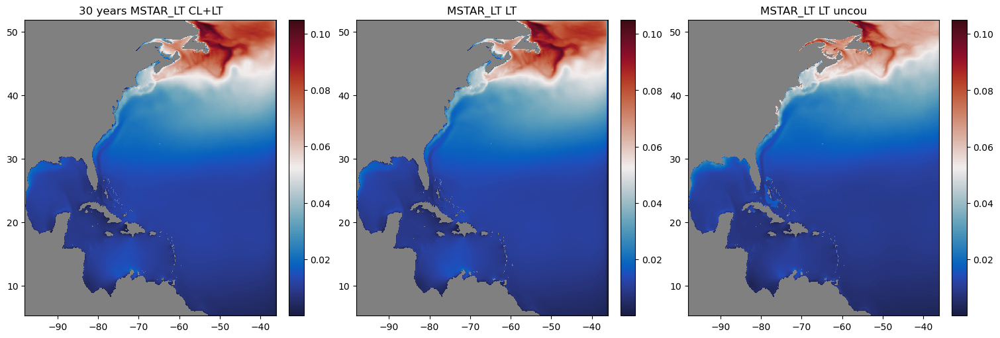

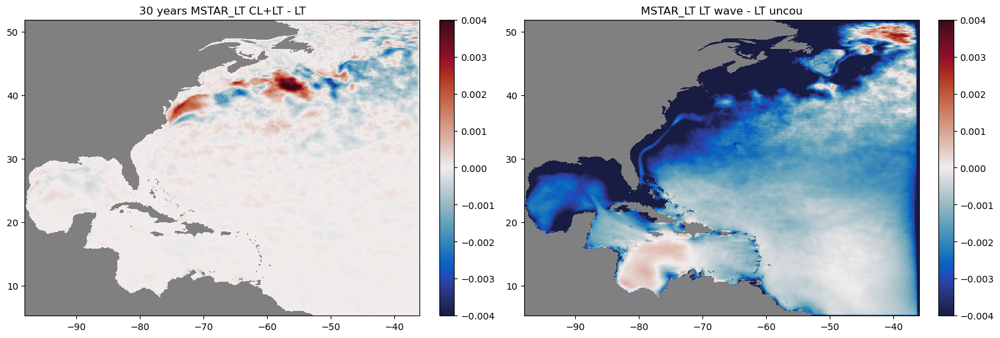

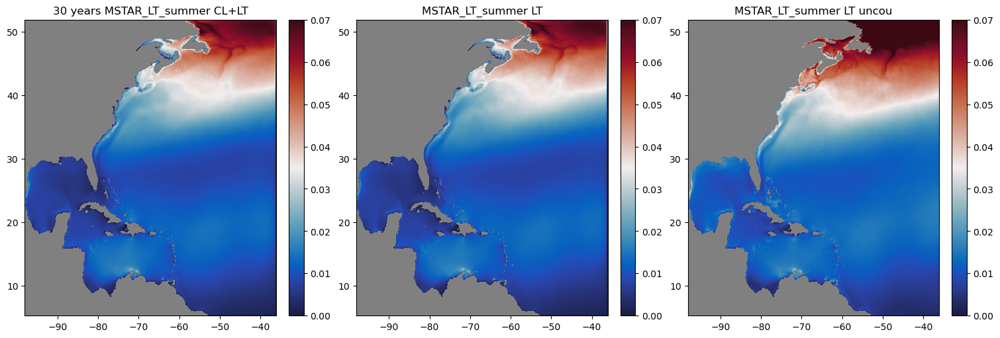

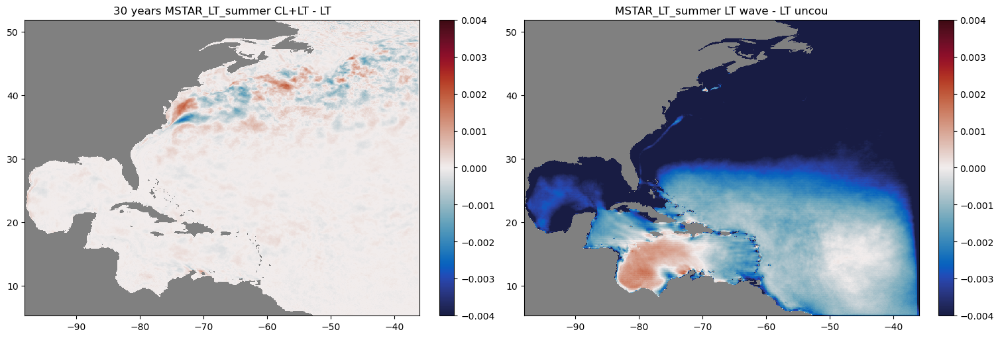

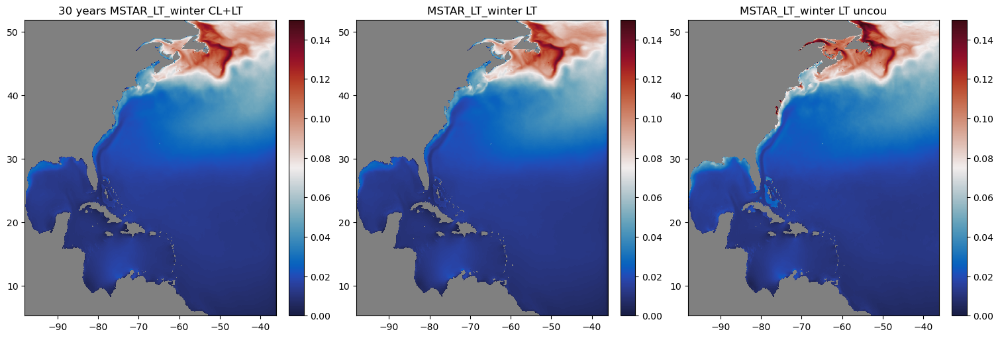

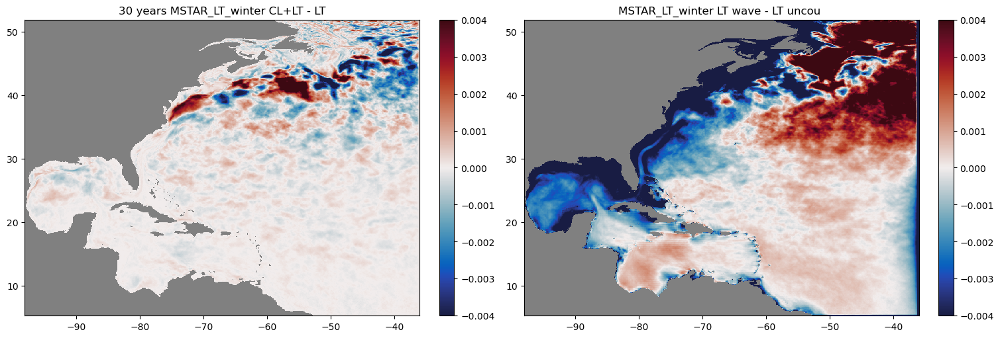

In [9]:
MSTAR_LT_uncou= Mcombined_data_uncou['MSTAR_LT']
MSTAR_LT_summer_uncou= Msummer_data_uncou['MSTAR_LT']
MSTAR_LT_winter_uncou= Mwinter_data_uncou['MSTAR_LT']
MSTAR_LT_uncou_ave=MSTAR_LT_uncou
MSTAR_LT_summer_uncou_ave=MSTAR_LT_summer_uncou
MSTAR_LT_winter_uncou_ave=MSTAR_LT_winter_uncou

MSTAR_LT_6_all= Mcombined_data_6_all['MSTAR_LT']
MSTAR_LT_summer_6_all= Msummer_data_6_all['MSTAR_LT']
MSTAR_LT_winter_6_all= Mwinter_data_6_all['MSTAR_LT']
MSTAR_LT_6_all_ave=MSTAR_LT_6_all
MSTAR_LT_summer_6_all_ave=MSTAR_LT_summer_6_all
MSTAR_LT_winter_6_all_ave=MSTAR_LT_winter_6_all

MSTAR_LT_6_wave= Mcombined_data_6_wave['MSTAR_LT']
MSTAR_LT_summer_6_wave= Msummer_data_6_wave['MSTAR_LT']
MSTAR_LT_winter_6_wave= Mwinter_data_6_wave['MSTAR_LT']
MSTAR_LT_6_wave_ave=MSTAR_LT_6_wave
MSTAR_LT_summer_6_wave_ave=MSTAR_LT_summer_6_wave
MSTAR_LT_winter_6_wave_ave=MSTAR_LT_winter_6_wave


diff_MSTAR_LT_uncou_ave=MSTAR_LT_6_wave_ave -MSTAR_LT_uncou_ave
diff_MSTAR_LT_all_ave=MSTAR_LT_6_all_ave-MSTAR_LT_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, MSTAR_LT_6_all_ave , cmap=cmap, shading='auto')
axes[0].set_title('30 years MSTAR_LT CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, MSTAR_LT_6_wave_ave, cmap=cmap, shading='auto')
axes[1].set_title('MSTAR_LT LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, MSTAR_LT_uncou_ave, cmap=cmap, shading='auto')
axes[2].set_title('MSTAR_LT LT uncou')
plt.colorbar(mesh2, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_MSTAR_LT_all_ave , cmap=cmap, shading='auto',vmin=-0.004,vmax=0.004)
axes[0].set_title('30 years MSTAR_LT CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_MSTAR_LT_uncou_ave, cmap=cmap, shading='auto',vmin=-0.004,vmax=0.004)
axes[1].set_title('MSTAR_LT LT wave - LT uncou')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

plt.show()


diff_MSTAR_LT_summer_uncou_ave=MSTAR_LT_summer_6_wave_ave - MSTAR_LT_summer_uncou_ave
diff_MSTAR_LT_summer_all_ave=MSTAR_LT_summer_6_all_ave-MSTAR_LT_summer_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, MSTAR_LT_summer_6_all_ave , cmap=cmap, shading='auto',vmin=0,vmax=0.07)
axes[0].set_title('30 years MSTAR_LT_summer CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, MSTAR_LT_summer_6_wave_ave, cmap=cmap, shading='auto',vmin=0,vmax=0.07)
axes[1].set_title('MSTAR_LT_summer LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, MSTAR_LT_summer_uncou_ave, cmap=cmap, shading='auto',vmin=0,vmax=0.07)
axes[2].set_title('MSTAR_LT_summer LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot

# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_MSTAR_LT_summer_all_ave , cmap=cmap, shading='auto',vmin=-0.004,vmax=0.004)
axes[0].set_title('30 years MSTAR_LT_summer CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_MSTAR_LT_summer_uncou_ave, cmap=cmap, shading='auto',vmin=-0.004,vmax=0.004)
axes[1].set_title('MSTAR_LT_summer LT wave - LT uncou')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
plt.show()

diff_MSTAR_LT_winter_uncou_ave= MSTAR_LT_winter_6_wave_ave - MSTAR_LT_winter_uncou_ave
diff_MSTAR_LT_winter_all_ave=MSTAR_LT_winter_6_all_ave-MSTAR_LT_winter_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, MSTAR_LT_winter_6_all_ave , cmap=cmap, shading='auto',vmin=0,vmax=0.15)
axes[0].set_title('30 years MSTAR_LT_winter CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, MSTAR_LT_winter_6_wave_ave, cmap=cmap, shading='auto',vmin=0,vmax=0.15)
axes[1].set_title('MSTAR_LT_winter LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, MSTAR_LT_winter_uncou_ave, cmap=cmap, shading='auto',vmin=0,vmax=0.15)
axes[2].set_title('MSTAR_LT_winter LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot

# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_MSTAR_LT_winter_all_ave , cmap=cmap, shading='auto',vmin=-0.004,vmax=0.004)
axes[0].set_title('30 years MSTAR_LT_winter CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_MSTAR_LT_winter_uncou_ave, cmap=cmap, shading='auto',vmin=-0.004,vmax=0.004)
axes[1].set_title('MSTAR_LT_winter LT wave - LT uncou ')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot


plt.show()

In [13]:
MSTAR_6_wave_ave
print("MSTAR_6_all_ave:", np.nanmin(MSTAR_6_all_ave), np.nanmax(MSTAR_6_all_ave))
print("MSTAR_6_wave_ave:", np.nanmin(MSTAR_6_wave_ave), np.nanmax(MSTAR_6_wave_ave))
print("MSTAR_uncou_ave:", np.nanmin(MSTAR_uncou_ave), np.nanmax(MSTAR_uncou_ave))

MSTAR_6_all_ave: 0.3870318094889323 461.05933159722224
MSTAR_6_wave_ave: 0.38401590983072914 458.8552517361111
MSTAR_uncou_ave: 0.46477589077419706 461.3353298611111


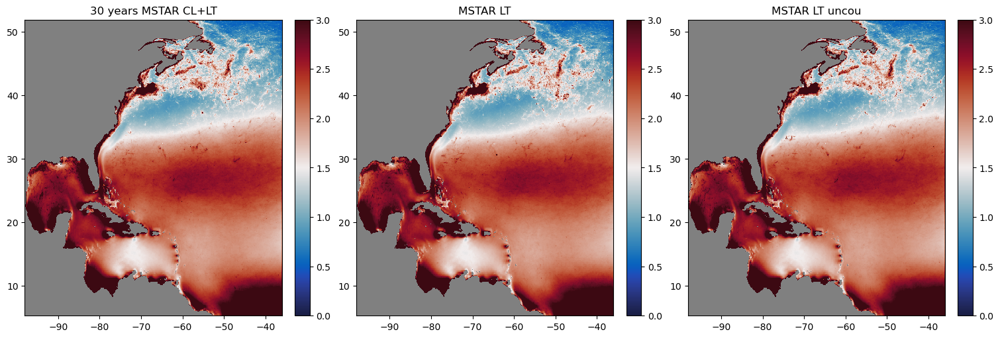

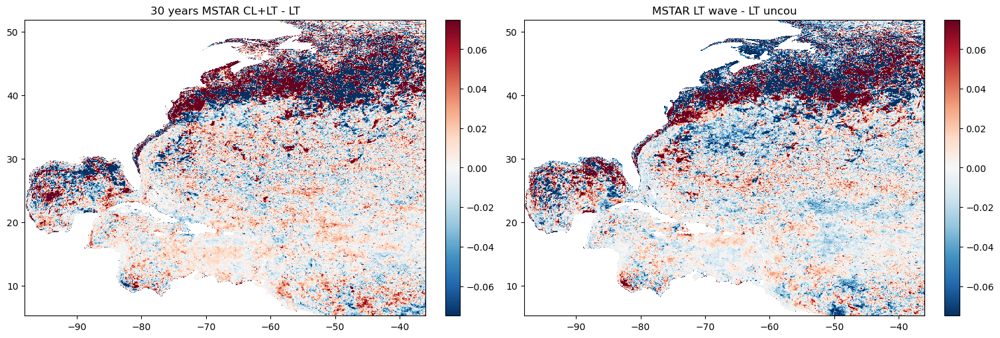

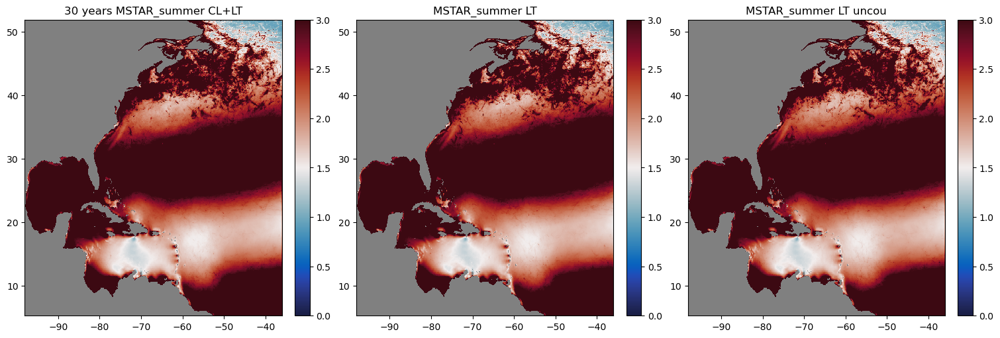

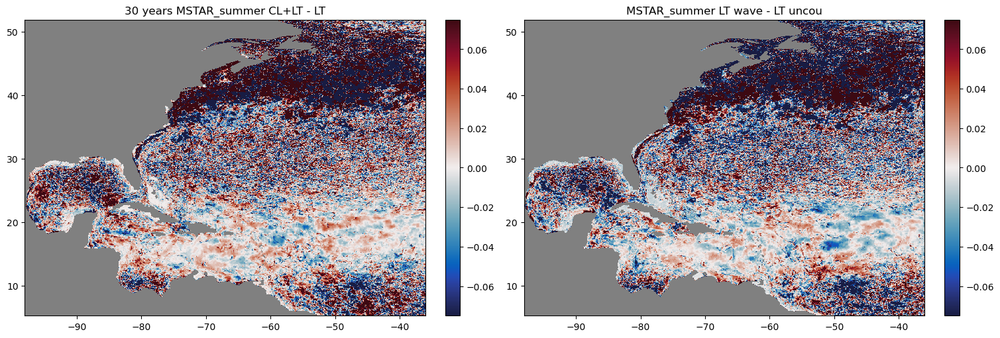

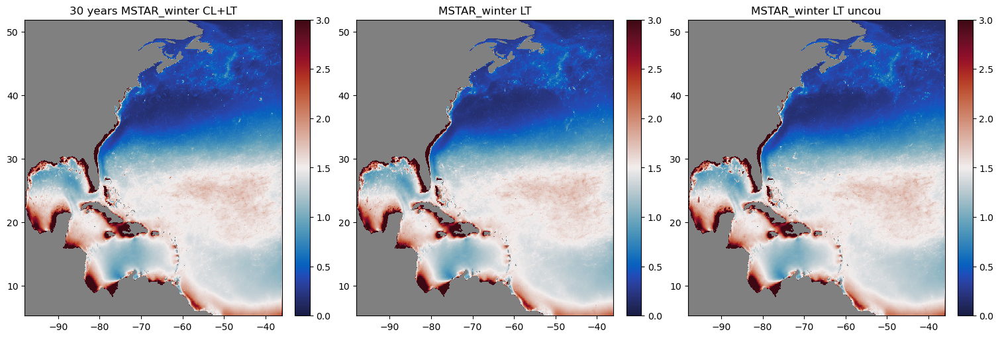

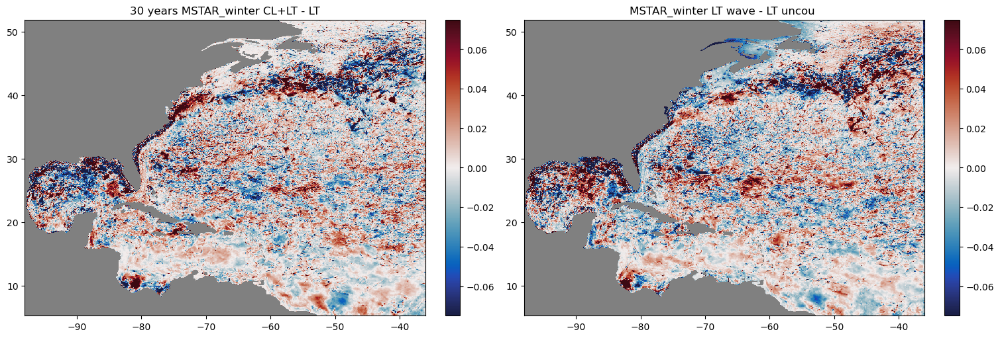

In [25]:
MSTAR_uncou= Mcombined_data_uncou['MSTAR']
MSTAR_summer_uncou= Msummer_data_uncou['MSTAR']
MSTAR_winter_uncou= Mwinter_data_uncou['MSTAR']
MSTAR_uncou_ave=MSTAR_uncou
MSTAR_summer_uncou_ave=MSTAR_summer_uncou
MSTAR_winter_uncou_ave=MSTAR_winter_uncou

MSTAR_6_all= Mcombined_data_6_all['MSTAR']
MSTAR_summer_6_all= Msummer_data_6_all['MSTAR']
MSTAR_winter_6_all= Mwinter_data_6_all['MSTAR']
MSTAR_6_all_ave=MSTAR_6_all
MSTAR_summer_6_all_ave=MSTAR_summer_6_all
MSTAR_winter_6_all_ave=MSTAR_winter_6_all

MSTAR_6_wave= Mcombined_data_6_wave['MSTAR']
MSTAR_summer_6_wave= Msummer_data_6_wave['MSTAR']
MSTAR_winter_6_wave= Mwinter_data_6_wave['MSTAR']
MSTAR_6_wave_ave=MSTAR_6_wave
MSTAR_summer_6_wave_ave=MSTAR_summer_6_wave
MSTAR_winter_6_wave_ave=MSTAR_winter_6_wave


diff_MSTAR_uncou_ave=MSTAR_6_wave_ave -MSTAR_uncou_ave
diff_MSTAR_all_ave=MSTAR_6_all_ave-MSTAR_6_wave_ave

abs_max=0.075
avmin,avmax=0,3
# Use symmetric range around 0
vmin, vmax = -abs_max, abs_max
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, MSTAR_6_all_ave , cmap=cmap, shading='auto', vmin=avmin, vmax=avmax)
axes[0].set_title('30 years MSTAR CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, MSTAR_6_wave_ave, cmap=cmap, shading='auto', vmin=avmin, vmax=avmax)
axes[1].set_title('MSTAR LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, MSTAR_uncou_ave, cmap=cmap, shading='auto', vmin=avmin, vmax=avmax)
axes[2].set_title('MSTAR LT uncou')
plt.colorbar(mesh2, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_MSTAR_all_ave , cmap='RdBu_r', shading='auto', vmin=vmin, vmax=vmax)
axes[0].set_title('30 years MSTAR CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot
# axes[0].contour(model_grid_x, model_grid_y, diff_MSTAR_all_ave, levels=10, colors='black', linewidths=0.5)

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_MSTAR_uncou_ave, cmap='RdBu_r', shading='auto', vmin=vmin, vmax=vmax)
axes[1].set_title('MSTAR LT wave - LT uncou')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
# axes[1].contour(model_grid_x, model_grid_y, diff_MSTAR_uncou_ave, levels=10, colors='black', linewidths=0.5)

plt.show()


diff_MSTAR_summer_uncou_ave=MSTAR_summer_6_wave_ave - MSTAR_summer_uncou_ave
diff_MSTAR_summer_all_ave=MSTAR_summer_6_all_ave-MSTAR_summer_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, MSTAR_summer_6_all_ave , cmap=cmap, shading='auto', vmin=avmin, vmax=avmax)
axes[0].set_title('30 years MSTAR_summer CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, MSTAR_summer_6_wave_ave, cmap=cmap, shading='auto', vmin=avmin, vmax=avmax)
axes[1].set_title('MSTAR_summer LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, MSTAR_summer_uncou_ave, cmap=cmap, shading='auto', vmin=avmin, vmax=avmax)
axes[2].set_title('MSTAR_summer LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot

# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_MSTAR_summer_all_ave , cmap=cmap, shading='auto', vmin=vmin, vmax=vmax)
axes[0].set_title('30 years MSTAR_summer CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_MSTAR_summer_uncou_ave, cmap=cmap, shading='auto', vmin=vmin, vmax=vmax)
axes[1].set_title('MSTAR_summer LT wave - LT uncou')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
plt.show()

diff_MSTAR_winter_uncou_ave= MSTAR_winter_6_wave_ave - MSTAR_winter_uncou_ave
diff_MSTAR_winter_all_ave=MSTAR_winter_6_all_ave-MSTAR_winter_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, MSTAR_winter_6_all_ave , cmap=cmap, shading='auto', vmin=avmin, vmax=avmax)
axes[0].set_title('30 years MSTAR_winter CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, MSTAR_winter_6_wave_ave, cmap=cmap, shading='auto', vmin=avmin, vmax=avmax)
axes[1].set_title('MSTAR_winter LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, MSTAR_winter_uncou_ave, cmap=cmap, shading='auto', vmin=avmin, vmax=avmax)
axes[2].set_title('MSTAR_winter LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot

# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_MSTAR_winter_all_ave , cmap=cmap, shading='auto', vmin=vmin, vmax=vmax)
axes[0].set_title('30 years MSTAR_winter CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_MSTAR_winter_uncou_ave, cmap=cmap, shading='auto', vmin=vmin, vmax=vmax)
axes[1].set_title('MSTAR_winter LT wave - LT uncou ')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot


plt.show()

In [17]:
print("Max abs diff (CL+LT - LT):", np.nanmax(np.abs(diff_MSTAR_all_ave)))
print("Max abs diff (LT wave - LT uncou):", np.nanmax(np.abs(diff_MSTAR_uncou_ave)))

Max abs diff (CL+LT - LT): 86.68461371527778
Max abs diff (LT wave - LT uncou): 82.53617621527778


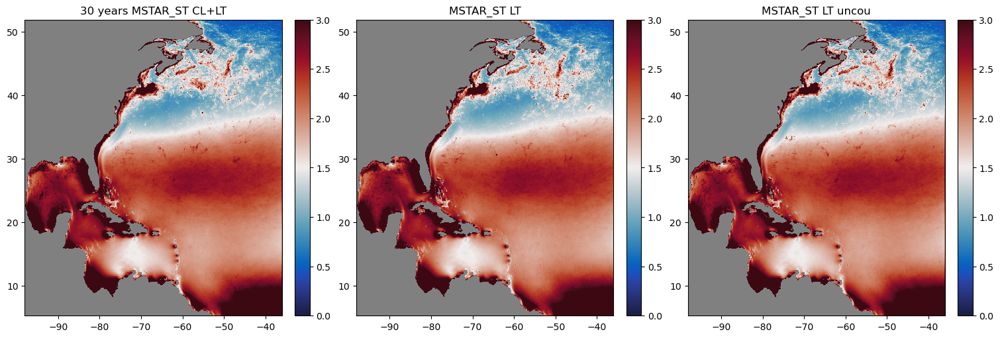

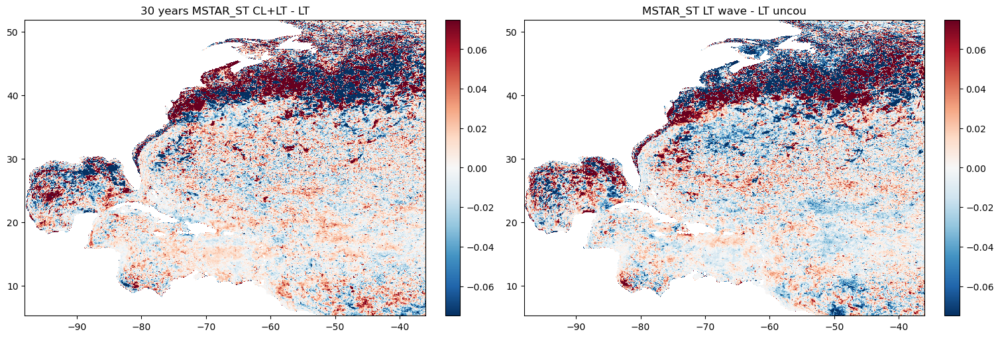

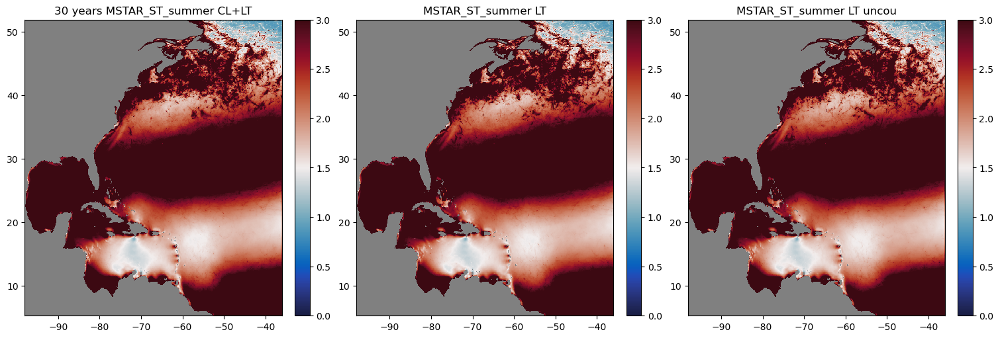

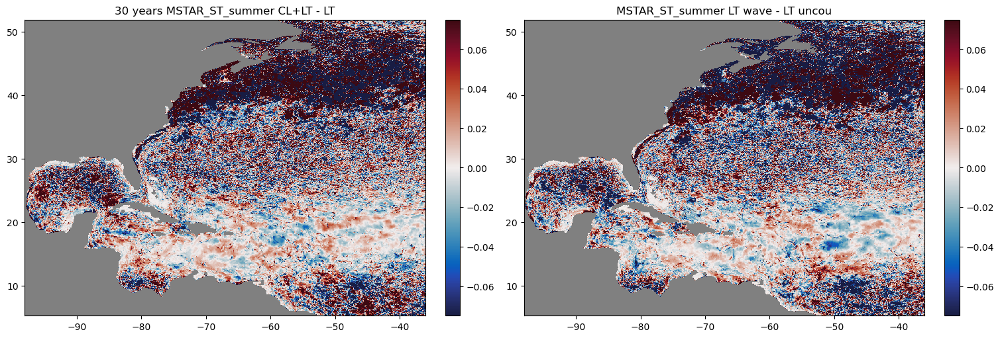

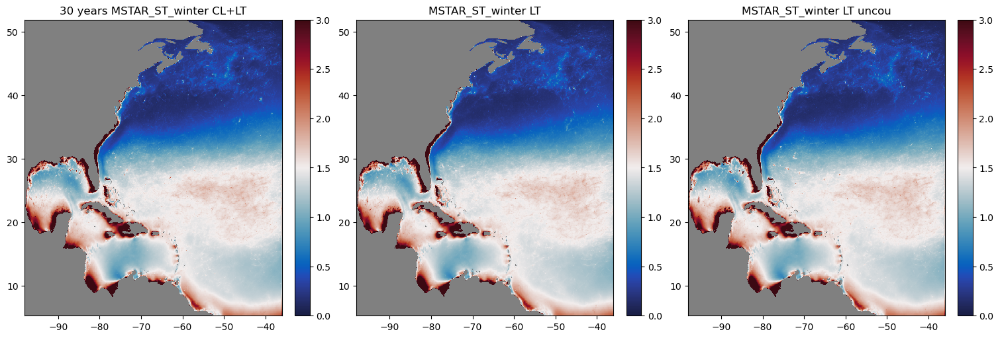

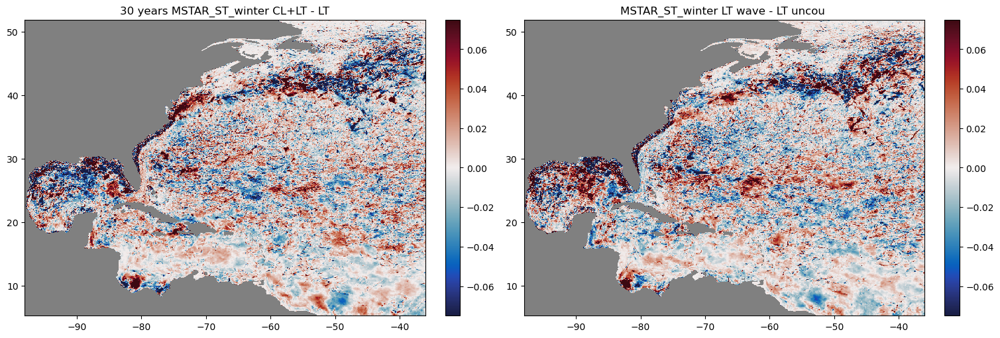

In [26]:
MSTAR_uncou= Mcombined_data_uncou['MSTAR']
MSTAR_summer_uncou= Msummer_data_uncou['MSTAR']
MSTAR_winter_uncou= Mwinter_data_uncou['MSTAR']
MSTAR_ST_uncou=MSTAR_uncou-MSTAR_LT_uncou
MSTAR_ST_summer_uncou=MSTAR_summer_uncou-MSTAR_LT_summer_uncou
MSTAR_ST_winter_uncou=MSTAR_winter_uncou-MSTAR_LT_winter_uncou

MSTAR_ST_uncou_ave=MSTAR_ST_uncou
MSTAR_ST_summer_uncou_ave=MSTAR_ST_summer_uncou
MSTAR_ST_winter_uncou_ave=MSTAR_ST_winter_uncou

MSTAR_6_all= Mcombined_data_6_all['MSTAR']
MSTAR_summer_6_all= Msummer_data_6_all['MSTAR']
MSTAR_winter_6_all= Mwinter_data_6_all['MSTAR']
MSTAR_ST_6_all=MSTAR_6_all-MSTAR_LT_6_all
MSTAR_ST_summer_6_all=MSTAR_summer_6_all-MSTAR_LT_summer_6_all
MSTAR_ST_winter_6_all=MSTAR_winter_6_all-MSTAR_LT_winter_6_all
MSTAR_ST_6_all_ave=MSTAR_ST_6_all
MSTAR_ST_summer_6_all_ave=MSTAR_ST_summer_6_all
MSTAR_ST_winter_6_all_ave=MSTAR_ST_winter_6_all

MSTAR_6_wave= Mcombined_data_6_wave['MSTAR']
MSTAR_summer_6_wave= Msummer_data_6_wave['MSTAR']
MSTAR_winter_6_wave= Mwinter_data_6_wave['MSTAR']
MSTAR_ST_6_wave=MSTAR_6_wave-MSTAR_LT_6_wave
MSTAR_ST_summer_6_wave=MSTAR_summer_6_wave-MSTAR_LT_summer_6_wave
MSTAR_ST_winter_6_wave=MSTAR_winter_6_wave-MSTAR_LT_winter_6_wave

MSTAR_ST_6_wave_ave=MSTAR_ST_6_wave
MSTAR_ST_summer_6_wave_ave=MSTAR_ST_summer_6_wave
MSTAR_ST_winter_6_wave_ave=MSTAR_ST_winter_6_wave


diff_MSTAR_ST_uncou_ave=MSTAR_ST_6_wave_ave -MSTAR_ST_uncou_ave
diff_MSTAR_ST_all_ave=MSTAR_ST_6_all_ave-MSTAR_ST_6_wave_ave

abs_max=0.075
avmin,avmax=0,3
# Use symmetric range around 0
vmin, vmax = -abs_max, abs_max
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, MSTAR_ST_6_all_ave , cmap=cmap, shading='auto', vmin=avmin, vmax=avmax)
axes[0].set_title('30 years MSTAR_ST CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, MSTAR_ST_6_wave_ave, cmap=cmap, shading='auto', vmin=avmin, vmax=avmax)
axes[1].set_title('MSTAR_ST LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, MSTAR_ST_uncou_ave, cmap=cmap, shading='auto', vmin=avmin, vmax=avmax)
axes[2].set_title('MSTAR_ST LT uncou')
plt.colorbar(mesh2, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_MSTAR_ST_all_ave , cmap='RdBu_r', shading='auto', vmin=vmin, vmax=vmax)
axes[0].set_title('30 years MSTAR_ST CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot
# axes[0].contour(model_grid_x, model_grid_y, diff_MSTAR_ST_all_ave, levels=10, colors='black', linewidths=0.5)

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_MSTAR_ST_uncou_ave, cmap='RdBu_r', shading='auto', vmin=vmin, vmax=vmax)
axes[1].set_title('MSTAR_ST LT wave - LT uncou')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
# axes[1].contour(model_grid_x, model_grid_y, diff_MSTAR_ST_uncou_ave, levels=10, colors='black', linewidths=0.5)

plt.show()


diff_MSTAR_ST_summer_uncou_ave=MSTAR_ST_summer_6_wave_ave - MSTAR_ST_summer_uncou_ave
diff_MSTAR_ST_summer_all_ave=MSTAR_ST_summer_6_all_ave-MSTAR_ST_summer_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, MSTAR_ST_summer_6_all_ave , cmap=cmap, shading='auto', vmin=avmin, vmax=avmax)
axes[0].set_title('30 years MSTAR_ST_summer CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, MSTAR_ST_summer_6_wave_ave, cmap=cmap, shading='auto', vmin=avmin, vmax=avmax)
axes[1].set_title('MSTAR_ST_summer LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, MSTAR_ST_summer_uncou_ave, cmap=cmap, shading='auto', vmin=avmin, vmax=avmax)
axes[2].set_title('MSTAR_ST_summer LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot

# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_MSTAR_ST_summer_all_ave , cmap=cmap, shading='auto', vmin=vmin, vmax=vmax)
axes[0].set_title('30 years MSTAR_ST_summer CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_MSTAR_ST_summer_uncou_ave, cmap=cmap, shading='auto', vmin=vmin, vmax=vmax)
axes[1].set_title('MSTAR_ST_summer LT wave - LT uncou')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
plt.show()

diff_MSTAR_ST_winter_uncou_ave= MSTAR_ST_winter_6_wave_ave - MSTAR_ST_winter_uncou_ave
diff_MSTAR_ST_winter_all_ave=MSTAR_ST_winter_6_all_ave-MSTAR_ST_winter_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, MSTAR_ST_winter_6_all_ave , cmap=cmap, shading='auto', vmin=avmin, vmax=avmax)
axes[0].set_title('30 years MSTAR_ST_winter CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, MSTAR_ST_winter_6_wave_ave, cmap=cmap, shading='auto', vmin=avmin, vmax=avmax)
axes[1].set_title('MSTAR_ST_winter LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, MSTAR_ST_winter_uncou_ave, cmap=cmap, shading='auto', vmin=avmin, vmax=avmax)
axes[2].set_title('MSTAR_ST_winter LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot

# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_MSTAR_ST_winter_all_ave , cmap=cmap, shading='auto', vmin=vmin, vmax=vmax)
axes[0].set_title('30 years MSTAR_ST_winter CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_MSTAR_ST_winter_uncou_ave, cmap=cmap, shading='auto', vmin=vmin, vmax=vmax)
axes[1].set_title('MSTAR_ST_winter LT wave - LT uncou ')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot


plt.show()

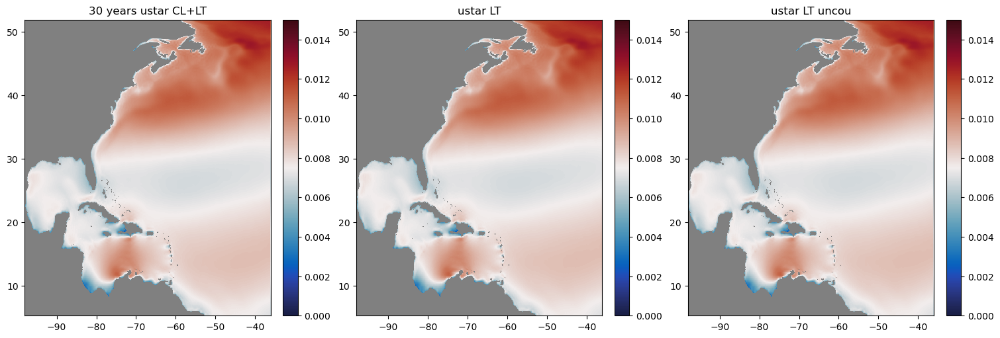

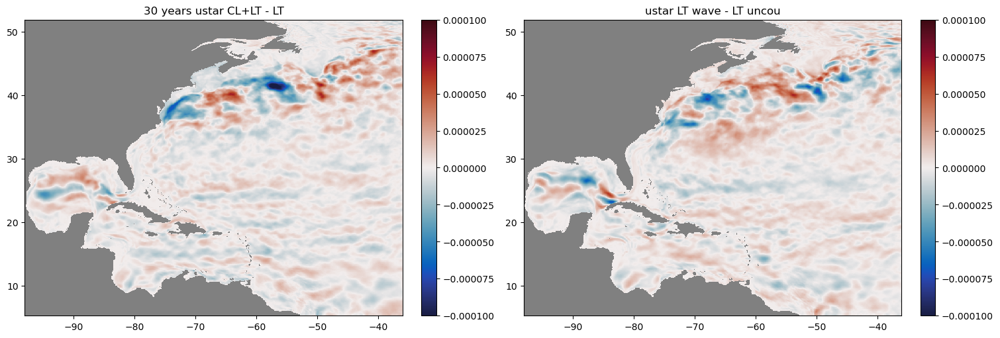

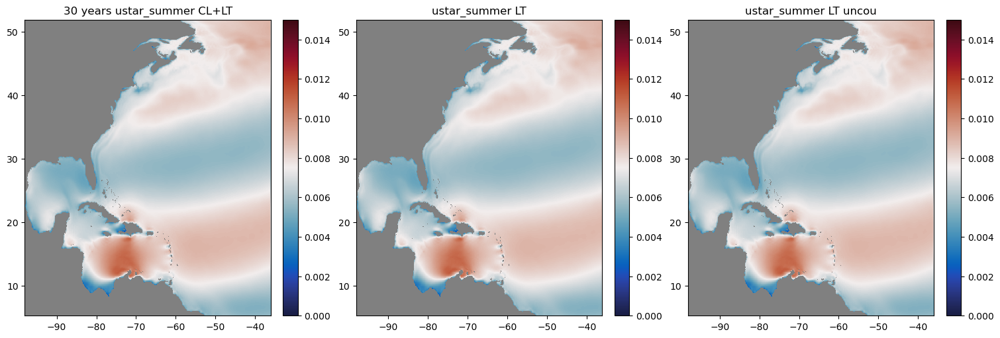

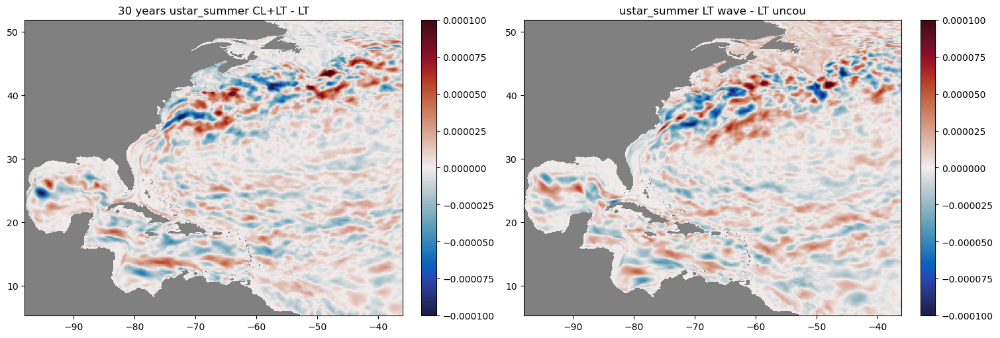

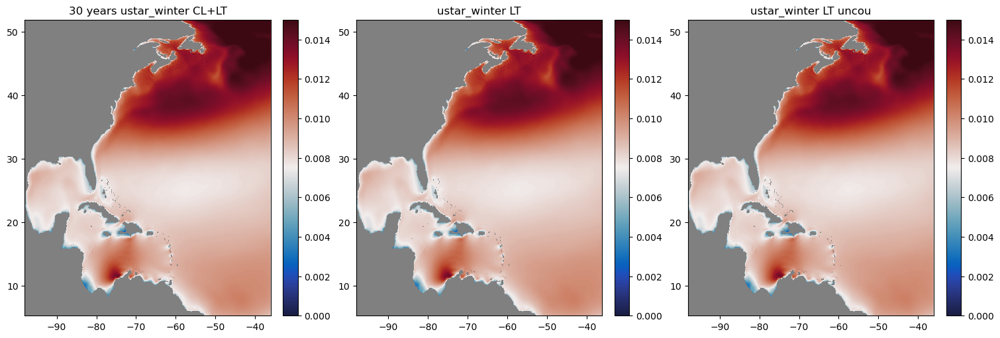

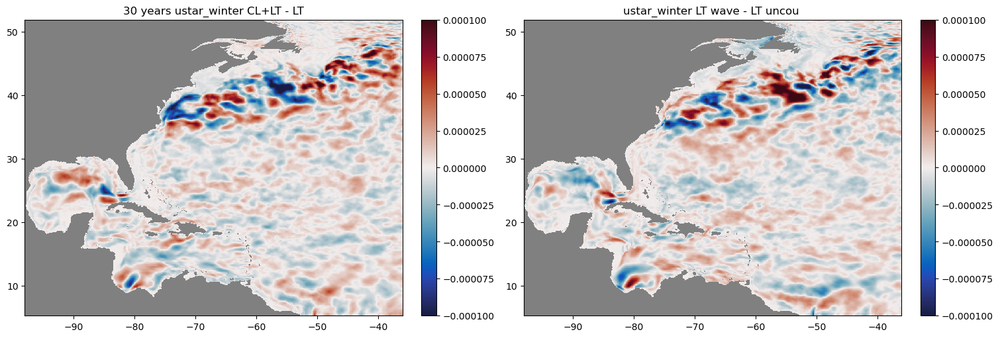

In [30]:
ustar_uncou= Mcombined_data_uncou['ustar']
ustar_summer_uncou= Msummer_data_uncou['ustar']
ustar_winter_uncou= Mwinter_data_uncou['ustar']
ustar_uncou_ave=ustar_uncou
ustar_summer_uncou_ave=ustar_summer_uncou
ustar_winter_uncou_ave=ustar_winter_uncou

ustar_6_all= Mcombined_data_6_all['ustar']
ustar_summer_6_all= Msummer_data_6_all['ustar']
ustar_winter_6_all= Mwinter_data_6_all['ustar']
ustar_6_all_ave=ustar_6_all
ustar_summer_6_all_ave=ustar_summer_6_all
ustar_winter_6_all_ave=ustar_winter_6_all

ustar_6_wave= Mcombined_data_6_wave['ustar']
ustar_summer_6_wave= Msummer_data_6_wave['ustar']
ustar_winter_6_wave= Mwinter_data_6_wave['ustar']
ustar_6_wave_ave=ustar_6_wave
ustar_summer_6_wave_ave=ustar_summer_6_wave
ustar_winter_6_wave_ave=ustar_winter_6_wave


diff_ustar_uncou_ave=ustar_6_wave_ave -ustar_uncou_ave
diff_ustar_all_ave=ustar_6_all_ave-ustar_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, ustar_6_all_ave , cmap=cmap, shading='auto',vmin=0,vmax=0.015)
axes[0].set_title('30 years ustar CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, ustar_6_wave_ave, cmap=cmap, shading='auto',vmin=0,vmax=0.015)
axes[1].set_title('ustar LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, ustar_uncou_ave, cmap=cmap, shading='auto',vmin=0,vmax=0.015)
axes[2].set_title('ustar LT uncou')
plt.colorbar(mesh2, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_ustar_all_ave , cmap=cmap, shading='auto',vmin=-0.0001,vmax=0.0001)
axes[0].set_title('30 years ustar CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_ustar_uncou_ave, cmap=cmap, shading='auto',vmin=-0.0001,vmax=0.0001)
axes[1].set_title('ustar LT wave - LT uncou')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

plt.show()


diff_ustar_summer_uncou_ave=ustar_summer_6_wave_ave - ustar_summer_uncou_ave
diff_ustar_summer_all_ave=ustar_summer_6_all_ave-ustar_summer_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, ustar_summer_6_all_ave , cmap=cmap, shading='auto',vmin=0,vmax=0.015)
axes[0].set_title('30 years ustar_summer CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, ustar_summer_6_wave_ave, cmap=cmap, shading='auto',vmin=0,vmax=0.015)
axes[1].set_title('ustar_summer LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, ustar_summer_uncou_ave, cmap=cmap, shading='auto',vmin=0,vmax=0.015)
axes[2].set_title('ustar_summer LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot

# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_ustar_summer_all_ave , cmap=cmap, shading='auto',vmin=-0.0001,vmax=0.0001)
axes[0].set_title('30 years ustar_summer CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_ustar_summer_uncou_ave, cmap=cmap, shading='auto',vmin=-0.0001,vmax=0.0001)
axes[1].set_title('ustar_summer LT wave - LT uncou')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
plt.show()

diff_ustar_winter_uncou_ave= ustar_winter_6_wave_ave - ustar_winter_uncou_ave
diff_ustar_winter_all_ave=ustar_winter_6_all_ave-ustar_winter_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, ustar_winter_6_all_ave , cmap=cmap, shading='auto',vmin=0,vmax=0.015)
axes[0].set_title('30 years ustar_winter CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, ustar_winter_6_wave_ave, cmap=cmap, shading='auto',vmin=0,vmax=0.015)
axes[1].set_title('ustar_winter LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, ustar_winter_uncou_ave, cmap=cmap, shading='auto',vmin=0,vmax=0.015)
axes[2].set_title('ustar_winter LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot

# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_ustar_winter_all_ave , cmap=cmap, shading='auto',vmin=-0.0001,vmax=0.0001)
axes[0].set_title('30 years ustar_winter CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_ustar_winter_uncou_ave, cmap=cmap, shading='auto',vmin=-0.0001,vmax=0.0001)
axes[1].set_title('ustar_winter LT wave - LT uncou ')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot


plt.show()

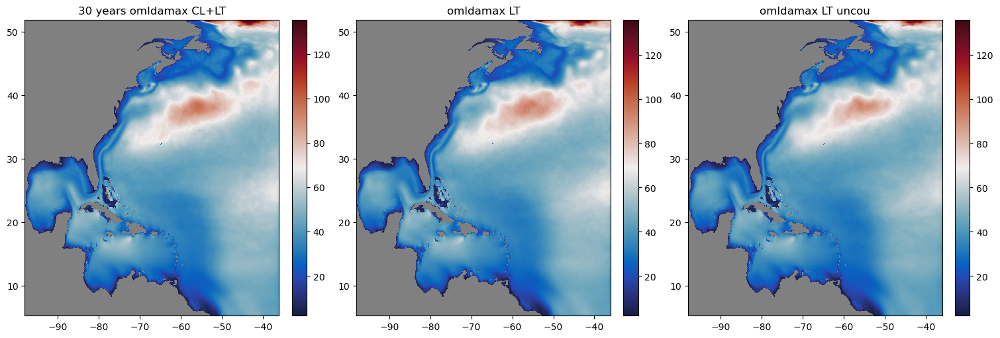

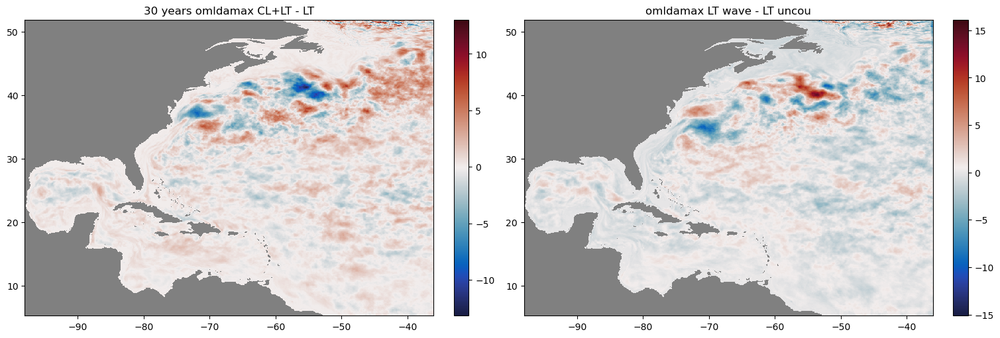

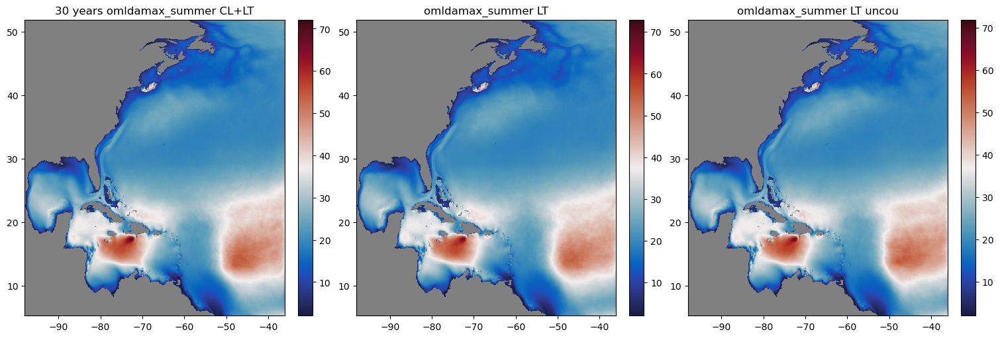

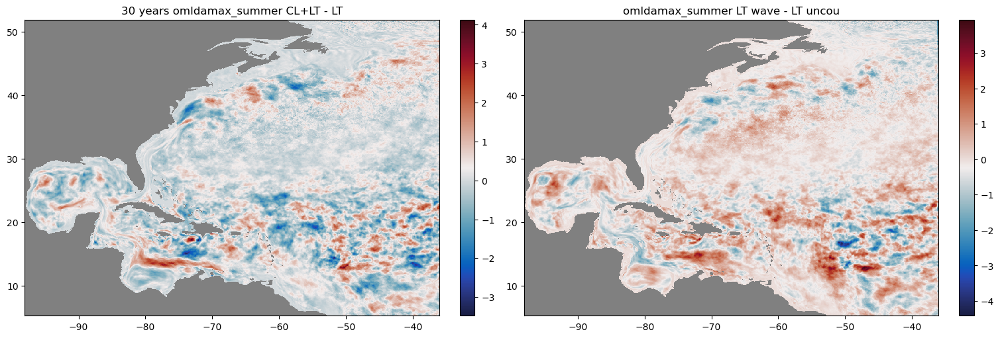

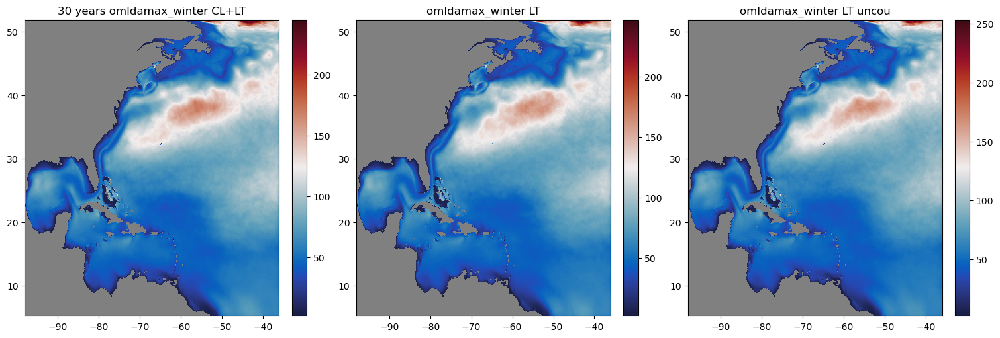

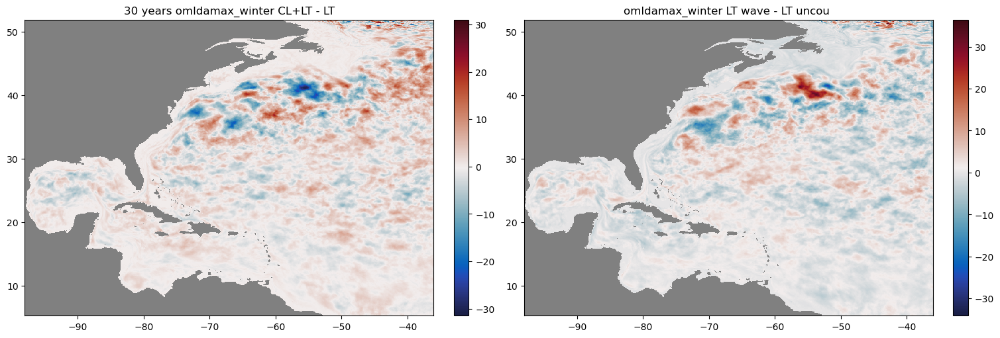

In [41]:
omldamax_uncou= Dcombined_data_uncou['omldamax']
omldamax_summer_uncou= Dsummer_data_uncou['omldamax']
omldamax_winter_uncou= Dwinter_data_uncou['omldamax']
omldamax_uncou_ave=omldamax_uncou
omldamax_summer_uncou_ave=omldamax_summer_uncou
omldamax_winter_uncou_ave=omldamax_winter_uncou

omldamax_6_all= Dcombined_data_6_all['omldamax']
omldamax_summer_6_all= Dsummer_data_6_all['omldamax']
omldamax_winter_6_all= Dwinter_data_6_all['omldamax']
omldamax_6_all_ave=omldamax_6_all
omldamax_summer_6_all_ave=omldamax_summer_6_all
omldamax_winter_6_all_ave=omldamax_winter_6_all

omldamax_6_wave= Dcombined_data_6_wave['omldamax']
omldamax_summer_6_wave= Dsummer_data_6_wave['omldamax']
omldamax_winter_6_wave= Dwinter_data_6_wave['omldamax']
omldamax_6_wave_ave=omldamax_6_wave
omldamax_summer_6_wave_ave=omldamax_summer_6_wave
omldamax_winter_6_wave_ave=omldamax_winter_6_wave


diff_omldamax_uncou_ave=omldamax_6_wave_ave -omldamax_uncou_ave
diff_omldamax_all_ave=omldamax_6_all_ave-omldamax_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, omldamax_6_all_ave , cmap=cmap, shading='auto')
axes[0].set_title('30 years omldamax CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, omldamax_6_wave_ave, cmap=cmap, shading='auto')
axes[1].set_title('omldamax LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, omldamax_uncou_ave, cmap=cmap, shading='auto')
axes[2].set_title('omldamax LT uncou')
plt.colorbar(mesh2, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_omldamax_all_ave , cmap=cmap, shading='auto')
axes[0].set_title('30 years omldamax CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_omldamax_uncou_ave, cmap=cmap, shading='auto')
axes[1].set_title('omldamax LT wave - LT uncou')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

plt.show()


diff_omldamax_summer_uncou_ave=omldamax_summer_6_wave_ave - omldamax_summer_uncou_ave
diff_omldamax_summer_all_ave=omldamax_summer_6_all_ave-omldamax_summer_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, omldamax_summer_6_all_ave , cmap=cmap, shading='auto')
axes[0].set_title('30 years omldamax_summer CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, omldamax_summer_6_wave_ave, cmap=cmap, shading='auto')
axes[1].set_title('omldamax_summer LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, omldamax_summer_uncou_ave, cmap=cmap, shading='auto')
axes[2].set_title('omldamax_summer LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot

# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_omldamax_summer_all_ave , cmap=cmap, shading='auto')
axes[0].set_title('30 years omldamax_summer CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_omldamax_summer_uncou_ave, cmap=cmap, shading='auto')
axes[1].set_title('omldamax_summer LT wave - LT uncou')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
plt.show()

diff_omldamax_winter_uncou_ave= omldamax_winter_6_wave_ave - omldamax_winter_uncou_ave
diff_omldamax_winter_all_ave=omldamax_winter_6_all_ave-omldamax_winter_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, omldamax_winter_6_all_ave , cmap=cmap, shading='auto')
axes[0].set_title('30 years omldamax_winter CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, omldamax_winter_6_wave_ave, cmap=cmap, shading='auto')
axes[1].set_title('omldamax_winter LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, omldamax_winter_uncou_ave, cmap=cmap, shading='auto')
axes[2].set_title('omldamax_winter LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot

# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_omldamax_winter_all_ave , cmap=cmap, shading='auto')
axes[0].set_title('30 years omldamax_winter CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_omldamax_winter_uncou_ave, cmap=cmap, shading='auto')
axes[1].set_title('omldamax_winter LT wave - LT uncou ')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot


plt.show()

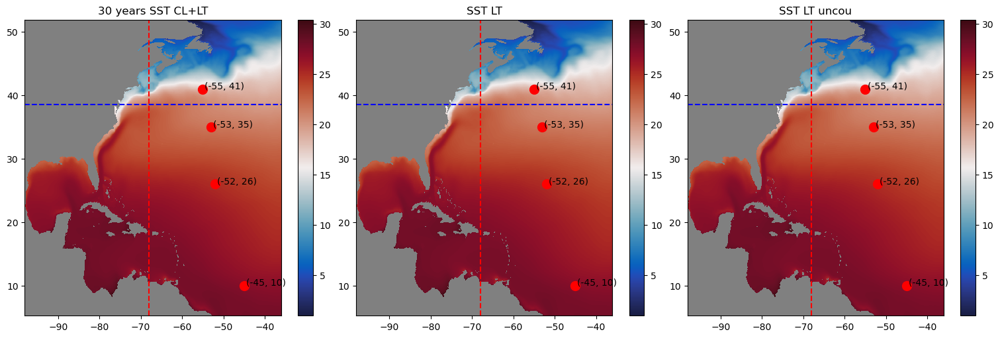

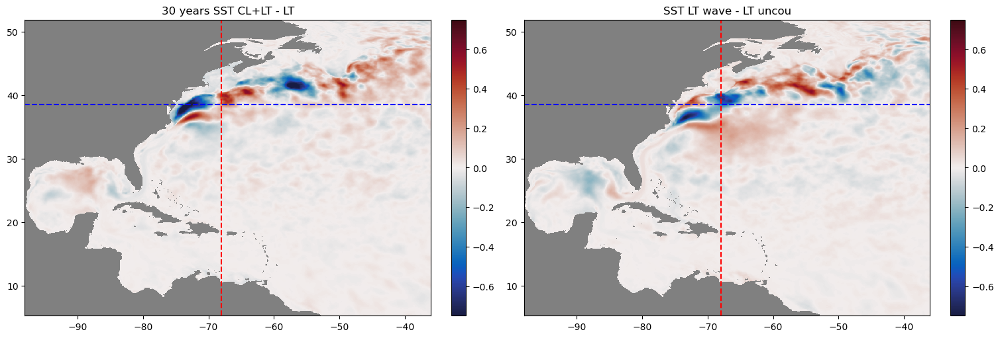

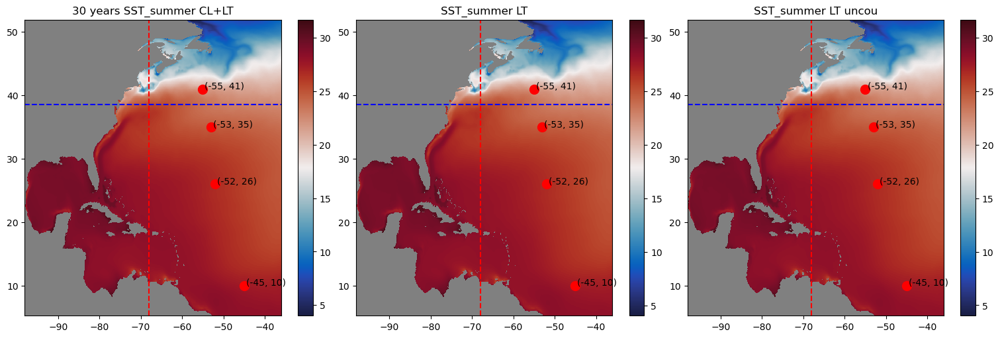

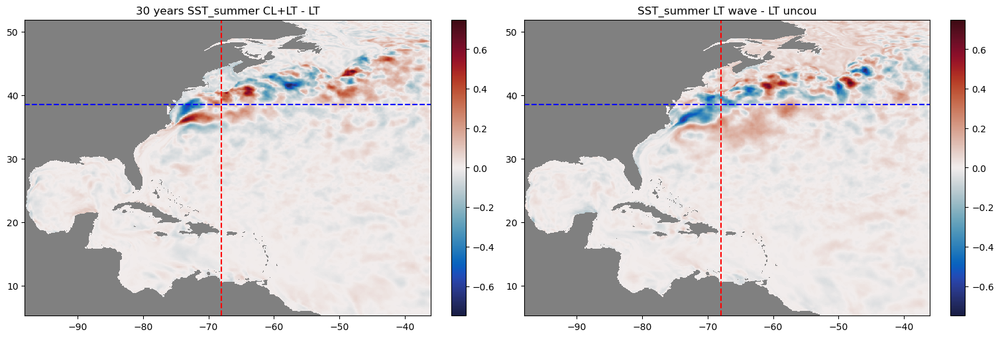

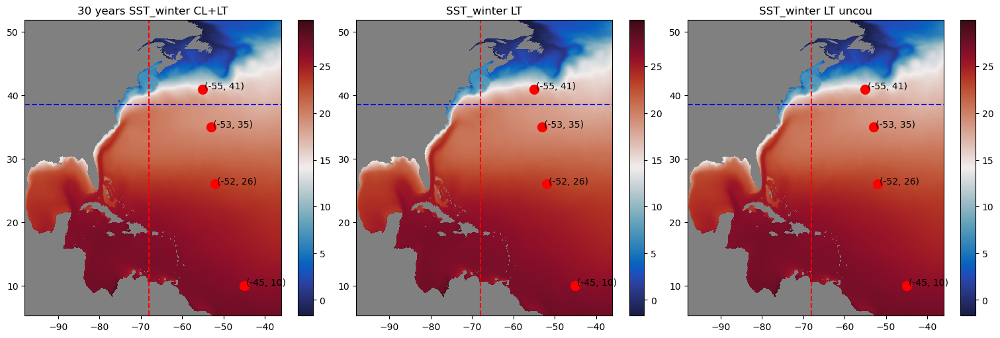

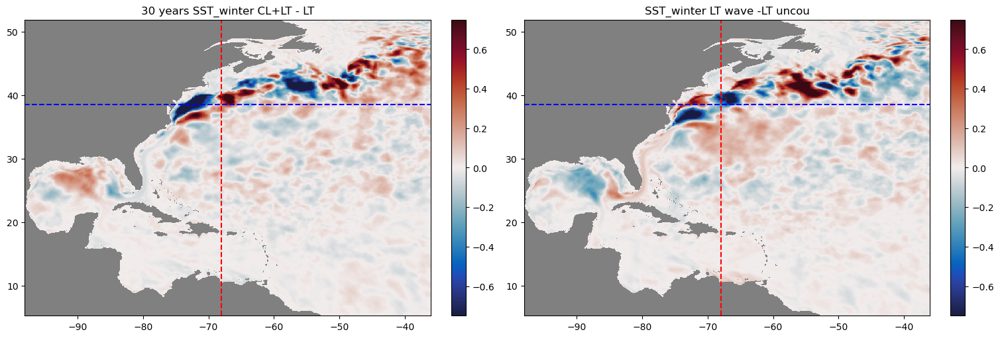

In [33]:
SST_uncou_ave= Dcombined_data_uncou['SST']
SST_summer_uncou_ave= Dsummer_data_uncou['SST']
SST_winter_uncou_ave= Dwinter_data_uncou['SST']

SST_6_all_ave= Dcombined_data_6_all['SST']
SST_summer_6_all_ave= Dsummer_data_6_all['SST']
SST_winter_6_all_ave= Dwinter_data_6_all['SST']

SST_6_wave_ave= Dcombined_data_6_wave['SST']
SST_summer_6_wave_ave= Dsummer_data_6_wave['SST']
SST_winter_6_wave_ave= Dwinter_data_6_wave['SST']

diff_SST_uncou_ave=SST_6_wave_ave - SST_uncou_ave
diff_SST_all_ave=SST_6_all_ave-SST_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, SST_6_all_ave , cmap=cmap, shading='auto')
axes[0].set_title('30 years SST CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, SST_6_wave_ave, cmap=cmap, shading='auto')
axes[1].set_title('SST LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, SST_uncou_ave, cmap=cmap, shading='auto')
axes[2].set_title('SST LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
axes[0].axvline(x=-68, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=38.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-68, color='red', linestyle='--')
axes[1].axhline(y=38.5, color='blue', linestyle='--')

axes[2].axvline(x=-68, color='red', linestyle='--')
axes[2].axhline(y=38.5, color='blue', linestyle='--')
# Show the plot
points = [(-45, 10), (-52, 26), (-53, 35), (-55,41)]  # Example points

for ax in axes:  # Loop over each subplot
    for lon, lat in points:
        ax.scatter(lon, lat, color='red', marker='o', s=100)  # Plot the point
        ax.text(lon + 0.5, lat, f'({lon}, {lat})', fontsize=10, color='black')  # Add label
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_SST_all_ave , cmap=cmap, shading='auto',vmin=-0.75,vmax=0.75)
axes[0].set_title('30 years SST CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_SST_uncou_ave, cmap=cmap, shading='auto',vmin=-0.75,vmax=0.75)
axes[1].set_title('SST LT wave - LT uncou')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
axes[0].axvline(x=-68, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=38.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-68, color='red', linestyle='--')
axes[1].axhline(y=38.5, color='blue', linestyle='--')
points = [(-45, 10), (-52, 26), (-53, 35), (-55,41)]  # Example points

plt.show()


diff_SST_summer_uncou_ave=SST_summer_6_wave_ave-SST_summer_uncou_ave
diff_SST_summer_all_ave=SST_summer_6_all_ave-SST_summer_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, SST_summer_6_all_ave , cmap=cmap, shading='auto')
axes[0].set_title('30 years SST_summer CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, SST_summer_6_wave_ave, cmap=cmap, shading='auto')
axes[1].set_title('SST_summer LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, SST_summer_uncou_ave, cmap=cmap, shading='auto')
axes[2].set_title('SST_summer LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
axes[0].axvline(x=-68, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=38.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-68, color='red', linestyle='--')
axes[1].axhline(y=38.5, color='blue', linestyle='--')
axes[2].axvline(x=-68, color='red', linestyle='--')
axes[2].axhline(y=38.5, color='blue', linestyle='--')
points = [(-45, 10), (-52, 26), (-53, 35), (-55,41)]  # Example points

for ax in axes:  # Loop over each subplot
    for lon, lat in points:
        ax.scatter(lon, lat, color='red', marker='o', s=100)  # Plot the point
        ax.text(lon + 0.5, lat, f'({lon}, {lat})', fontsize=10, color='black')  # Add label
# Show the plot
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_SST_summer_all_ave , cmap=cmap, shading='auto',vmin=-0.75,vmax=0.75)
axes[0].set_title('30 years SST_summer CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_SST_summer_uncou_ave, cmap=cmap, shading='auto',vmin=-0.75,vmax=0.75)
axes[1].set_title('SST_summer LT wave - LT uncou')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
axes[0].axvline(x=-68, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=38.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-68, color='red', linestyle='--')
axes[1].axhline(y=38.5, color='blue', linestyle='--')
points = [(-45, 10), (-52, 26), (-53, 35), (-55,41)]  # Example points


plt.show()

diff_SST_winter_uncou_ave=SST_winter_6_wave_ave - SST_winter_uncou_ave
diff_SST_winter_all_ave=SST_winter_6_all_ave-SST_winter_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, SST_winter_6_all_ave , cmap=cmap, shading='auto')
axes[0].set_title('30 years SST_winter CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, SST_winter_6_wave_ave, cmap=cmap, shading='auto')
axes[1].set_title('SST_winter LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, SST_winter_uncou_ave, cmap=cmap, shading='auto')
axes[2].set_title('SST_winter LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
axes[0].axvline(x=-68, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=38.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-68, color='red', linestyle='--')
axes[1].axhline(y=38.5, color='blue', linestyle='--')
axes[2].axvline(x=-68, color='red', linestyle='--')
axes[2].axhline(y=38.5, color='blue', linestyle='--')
points = [(-45, 10), (-52, 26), (-53, 35), (-55,41)]  # Example points

for ax in axes:  # Loop over each subplot
    for lon, lat in points:
        ax.scatter(lon, lat, color='red', marker='o', s=100)  # Plot the point
        ax.text(lon + 0.5, lat, f'({lon}, {lat})', fontsize=10, color='black')  # Add label
# Show the plot
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_SST_winter_all_ave , cmap=cmap, shading='auto',vmin=-0.75,vmax=0.75)
axes[0].set_title('30 years SST_winter CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_SST_winter_uncou_ave, cmap=cmap, shading='auto',vmin=-0.75,vmax=0.75)
axes[1].set_title('SST_winter LT wave -LT uncou')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
axes[0].axvline(x=-68, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=38.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-68, color='red', linestyle='--')
axes[1].axhline(y=38.5, color='blue', linestyle='--')

plt.show()

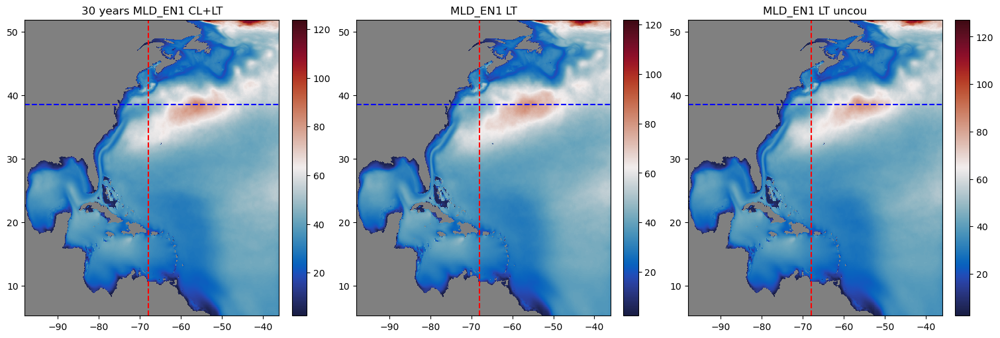

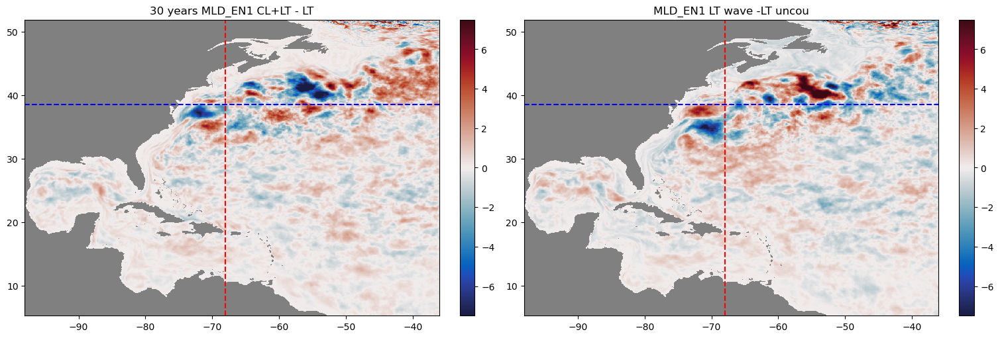

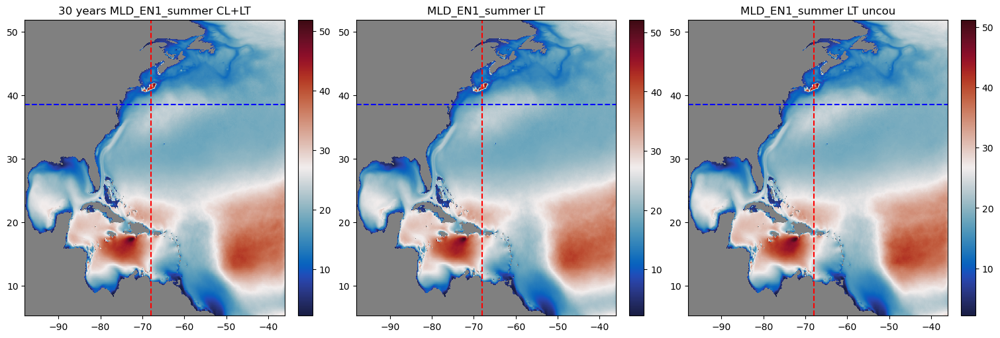

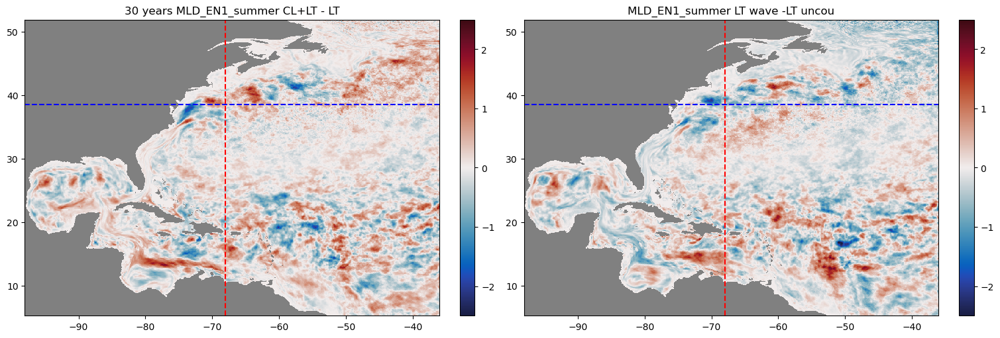

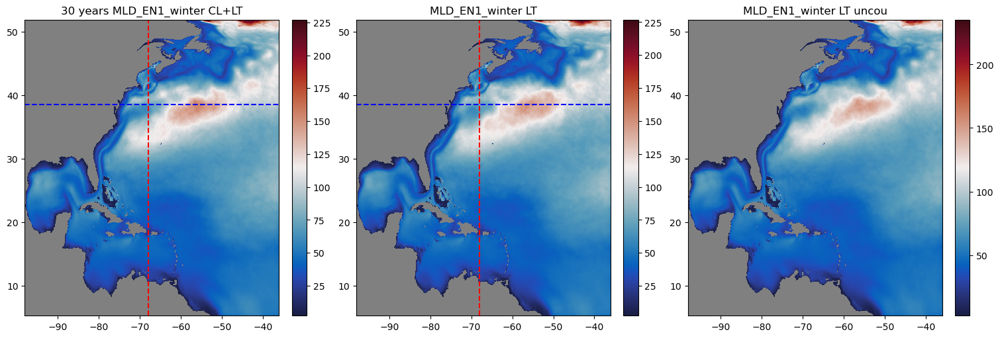

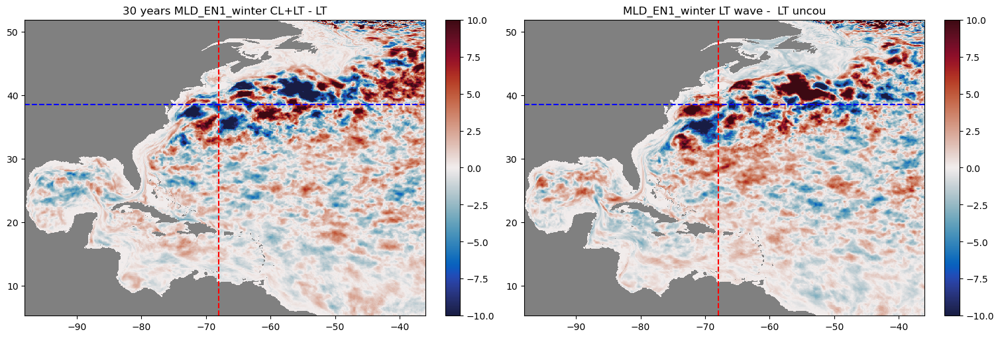

In [38]:
MLD_EN1_uncou_ave= Mcombined_data_uncou['MLD_EN1']
MLD_EN1_summer_uncou_ave= Msummer_data_uncou['MLD_EN1']
MLD_EN1_winter_uncou_ave= Mwinter_data_uncou['MLD_EN1']

MLD_EN1_6_all_ave= Mcombined_data_6_all['MLD_EN1']
MLD_EN1_summer_6_all_ave= Msummer_data_6_all['MLD_EN1']
MLD_EN1_winter_6_all_ave= Mwinter_data_6_all['MLD_EN1']

MLD_EN1_6_wave_ave= Mcombined_data_6_wave['MLD_EN1']
MLD_EN1_summer_6_wave_ave= Msummer_data_6_wave['MLD_EN1']
MLD_EN1_winter_6_wave_ave= Mwinter_data_6_wave['MLD_EN1']

diff_MLD_EN1_uncou_ave=MLD_EN1_6_wave_ave-MLD_EN1_uncou_ave
diff_MLD_EN1_all_ave=MLD_EN1_6_all_ave-MLD_EN1_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, MLD_EN1_6_all_ave , cmap=cmap, shading='auto')
axes[0].set_title('30 years MLD_EN1 CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, MLD_EN1_6_wave_ave, cmap=cmap, shading='auto')
axes[1].set_title('MLD_EN1 LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, MLD_EN1_uncou_ave, cmap=cmap, shading='auto')
axes[2].set_title('MLD_EN1 LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
axes[0].axvline(x=-68, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=38.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-68, color='red', linestyle='--')
axes[1].axhline(y=38.5, color='blue', linestyle='--')
axes[2].axvline(x=-68, color='red', linestyle='--')
axes[2].axhline(y=38.5, color='blue', linestyle='--')
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_MLD_EN1_all_ave , cmap=cmap, shading='auto',vmin=-7.5,vmax=7.5)
axes[0].set_title('30 years MLD_EN1 CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_MLD_EN1_uncou_ave, cmap=cmap, shading='auto',vmin=-7.5,vmax=7.5)
axes[1].set_title('MLD_EN1 LT wave -LT uncou')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
axes[0].axvline(x=-68, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=38.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-68, color='red', linestyle='--')
axes[1].axhline(y=38.5, color='blue', linestyle='--')
plt.show()


diff_MLD_EN1_summer_uncou_ave=MLD_EN1_summer_6_wave_ave-MLD_EN1_summer_uncou_ave
diff_MLD_EN1_summer_all_ave=MLD_EN1_summer_6_all_ave-MLD_EN1_summer_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, MLD_EN1_summer_6_all_ave , cmap=cmap, shading='auto')
axes[0].set_title('30 years MLD_EN1_summer CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, MLD_EN1_summer_6_wave_ave, cmap=cmap, shading='auto')
axes[1].set_title('MLD_EN1_summer LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, MLD_EN1_summer_uncou_ave, cmap=cmap, shading='auto')
axes[2].set_title('MLD_EN1_summer LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
axes[0].axvline(x=-68, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=38.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-68, color='red', linestyle='--')
axes[1].axhline(y=38.5, color='blue', linestyle='--')
axes[2].axvline(x=-68, color='red', linestyle='--')
axes[2].axhline(y=38.5, color='blue', linestyle='--')
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_MLD_EN1_summer_all_ave , cmap=cmap, shading='auto',vmin=-2.5,vmax=2.5)
axes[0].set_title('30 years MLD_EN1_summer CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_MLD_EN1_summer_uncou_ave, cmap=cmap, shading='auto',vmin=-2.5,vmax=2.5)
axes[1].set_title('MLD_EN1_summer LT wave -LT uncou')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
axes[0].axvline(x=-68, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=38.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-68, color='red', linestyle='--')
axes[1].axhline(y=38.5, color='blue', linestyle='--')
plt.show()

diff_MLD_EN1_winter_uncou_ave=MLD_EN1_winter_6_wave_ave-MLD_EN1_winter_uncou_ave
diff_MLD_EN1_winter_all_ave=MLD_EN1_winter_6_all_ave-MLD_EN1_winter_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, MLD_EN1_winter_6_all_ave , cmap=cmap, shading='auto')
axes[0].set_title('30 years MLD_EN1_winter CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, MLD_EN1_winter_6_wave_ave, cmap=cmap, shading='auto')
axes[1].set_title('MLD_EN1_winter LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, MLD_EN1_winter_uncou_ave, cmap=cmap, shading='auto')
axes[2].set_title('MLD_EN1_winter LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
axes[0].axvline(x=-68, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=38.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-68, color='red', linestyle='--')
axes[1].axhline(y=38.5, color='blue', linestyle='--')
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_MLD_EN1_winter_all_ave , cmap=cmap, shading='auto',vmin=-10,vmax=10)
axes[0].set_title('30 years MLD_EN1_winter CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_MLD_EN1_winter_uncou_ave, cmap=cmap, shading='auto',vmin=-10,vmax=10)
axes[1].set_title('MLD_EN1_winter LT wave -  LT uncou')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
axes[0].axvline(x=-68, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=38.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-68, color='red', linestyle='--')
axes[1].axhline(y=38.5, color='blue', linestyle='--')
plt.show()

In [43]:
Mdata_list = [

    '20040101_results/20040101.ocean_month.nc',
    '20050101_results/20050101.ocean_month.nc',
    '20060101_results/20060101.ocean_month.nc',
    '20070101_results/20070101.ocean_month.nc',
    '20080101_results/20080101.ocean_month.nc',
    '20090101_results/20090101.ocean_month.nc',
    '20100101_results/20100101.ocean_month.nc',
    '20110101_results/20110101.ocean_month.nc',
    '20120101_results/20120101.ocean_month.nc',
    '20130101_results/20130101.ocean_month.nc',
    '20140101_results/20140101.ocean_month.nc',
    '20150101_results/20150101.ocean_month.nc',
    '20160101_results/20160101.ocean_month.nc',
    '20170101_results/20170101.ocean_month.nc',
    '20180101_results/20180101.ocean_month.nc',
    '20190101_results/20190101.ocean_month.nc',
    '20200101_results/20200101.ocean_month.nc',
    '20210101_results/20210101.ocean_month.nc',
    '20220101_results/20220101.ocean_month.nc',

]
WMdata_list = [

    '20040101_results/20040101.ocean_month.nc',
    '20040701_results/20040701.ocean_month.nc',
    '20050101_results/20050101.ocean_month.nc',
    '20050701_results/20050701.ocean_month.nc',
    '20060101_results/20060101.ocean_month.nc',
    '20060701_results/20060701.ocean_month.nc',
    '20070101_results/20070101.ocean_month.nc',
    '20070701_results/20070701.ocean_month.nc',
    '20080101_results/20080101.ocean_month.nc',
    '20080701_results/20080701.ocean_month.nc',
    '20090101_results/20090101.ocean_month.nc',
    '20090701_results/20090701.ocean_month.nc',
    '20100101_results/20100101.ocean_month.nc',
    '20100701_results/20100701.ocean_month.nc',
    '20110101_results/20110101.ocean_month.nc',
    '20110701_results/20110701.ocean_month.nc',
    '20120101_results/20120101.ocean_month.nc',
    '20120701_results/20120701.ocean_month.nc',
    '20130101_results/20130101.ocean_month.nc',
    '20130701_results/20130701.ocean_month.nc',
    '20140101_results/20140101.ocean_month.nc',
    '20140701_results/20140701.ocean_month.nc',
    '20150101_results/20150101.ocean_month.nc',
    '20150701_results/20150701.ocean_month.nc',
    '20160101_results/20160101.ocean_month.nc',
    '20160701_results/20160701.ocean_month.nc',
    '20170101_results/20170101.ocean_month.nc',
    '20170701_results/20170701.ocean_month.nc',
    '20180101_results/20180101.ocean_month.nc',
    '20180701_results/20180701.ocean_month.nc',
    '20190101_results/20190101.ocean_month.nc',
    '20190701_results/20190701.ocean_month.nc',
    '20200101_results/20200101.ocean_month.nc',
    '20200701_results/20200701.ocean_month.nc',
    '20210101_results/20210101.ocean_month.nc',
    '20210701_results/20210701.ocean_month.nc',
    '20220101_results/20220101.ocean_month.nc',
    '20220701_results/20220701.ocean_month.nc',
]

def compute_weighted_mean_product_seasonal_MSTAR_LT(pp_root, data_list):
    combined_sum = None
    combined_count = None

    summer_sum = None
    summer_count = None

    winter_sum = None
    winter_count = None

    for file_path in data_list:
        file_path = os.path.join(pp_root, file_path)
        if os.path.exists(file_path):
            try:
                ds = xr.open_dataset(file_path)

                if 'MSTAR_LT' in ds and 'ustar' in ds:
                    mstar = ds['MSTAR_LT']
                    ustar_cubed = ds['ustar'] ** 3
                    product = mstar * ustar_cubed

                    # --- All time ---
                    valid_count = product.notnull().sum(dim='time')
                    if valid_count.sum() > 0:
                        product_sum = product.sum(dim='time', skipna=True)

                        if combined_sum is None:
                            combined_sum = product_sum
                            combined_count = valid_count
                        else:
                            combined_sum += product_sum
                            combined_count += valid_count

                    # --- Summer (JJA) ---
                    summer = ds.sel(time=ds['time'].dt.month.isin([6, 7, 8]))
                    product_summer = summer['MSTAR_LT'] * (summer['ustar'] ** 3)
                    summer_valid = product_summer.notnull().sum(dim='time')

                    if summer_valid.sum() > 0:
                        summer_sum_tmp = product_summer.sum(dim='time', skipna=True)

                        if summer_sum is None:
                            summer_sum = summer_sum_tmp
                            summer_count = summer_valid
                        else:
                            summer_sum += summer_sum_tmp
                            summer_count += summer_valid

                    # --- Winter (DJF) ---
                    winter = ds.sel(time=ds['time'].dt.month.isin([12, 1, 2]))
                    product_winter = winter['MSTAR_LT'] * (winter['ustar'] ** 3)
                    winter_valid = product_winter.notnull().sum(dim='time')

                    if winter_valid.sum() > 0:
                        winter_sum_tmp = product_winter.sum(dim='time', skipna=True)

                        if winter_sum is None:
                            winter_sum = winter_sum_tmp
                            winter_count = winter_valid
                        else:
                            winter_sum += winter_sum_tmp
                            winter_count += winter_valid

                else:
                    print(f"Missing variables in {file_path}")

                ds.close()

            except Exception as e:
                print(f"Error reading {file_path}: {e}")
        else:
            print(f"File not found: {file_path}")

    # Final averages
    combined_data = combined_sum / combined_count if combined_count is not None else None
    summer_data = summer_sum / summer_count if summer_count is not None else None
    winter_data = winter_sum / winter_count if winter_count is not None else None

    return combined_data, summer_data, winter_data
def compute_weighted_mean_product_seasonal_MSTAR(pp_root, data_list):
    combined_sum = None
    combined_count = None

    summer_sum = None
    summer_count = None

    winter_sum = None
    winter_count = None

    for file_path in data_list:
        file_path = os.path.join(pp_root, file_path)
        if os.path.exists(file_path):
            try:
                ds = xr.open_dataset(file_path)

                if 'MSTAR' in ds and 'ustar' in ds:
                    mstar = ds['MSTAR']
                    ustar_cubed = ds['ustar'] ** 3
                    product = mstar * ustar_cubed

                    # --- All time ---
                    valid_count = product.notnull().sum(dim='time')
                    if valid_count.sum() > 0:
                        product_sum = product.sum(dim='time', skipna=True)

                        if combined_sum is None:
                            combined_sum = product_sum
                            combined_count = valid_count
                        else:
                            combined_sum += product_sum
                            combined_count += valid_count

                    # --- Summer (JJA) ---
                    summer = ds.sel(time=ds['time'].dt.month.isin([6, 7, 8]))
                    product_summer = summer['MSTAR'] * (summer['ustar'] ** 3)
                    summer_valid = product_summer.notnull().sum(dim='time')

                    if summer_valid.sum() > 0:
                        summer_sum_tmp = product_summer.sum(dim='time', skipna=True)

                        if summer_sum is None:
                            summer_sum = summer_sum_tmp
                            summer_count = summer_valid
                        else:
                            summer_sum += summer_sum_tmp
                            summer_count += summer_valid

                    # --- Winter (DJF) ---
                    winter = ds.sel(time=ds['time'].dt.month.isin([12, 1, 2]))
                    product_winter = winter['MSTAR'] * (winter['ustar'] ** 3)
                    winter_valid = product_winter.notnull().sum(dim='time')

                    if winter_valid.sum() > 0:
                        winter_sum_tmp = product_winter.sum(dim='time', skipna=True)

                        if winter_sum is None:
                            winter_sum = winter_sum_tmp
                            winter_count = winter_valid
                        else:
                            winter_sum += winter_sum_tmp
                            winter_count += winter_valid

                else:
                    print(f"Missing variables in {file_path}")

                ds.close()

            except Exception as e:
                print(f"Error reading {file_path}: {e}")
        else:
            print(f"File not found: {file_path}")

    # Final averages
    combined_data = combined_sum / combined_count if combined_count is not None else None
    summer_data = summer_sum / summer_count if summer_count is not None else None
    winter_data = winter_sum / winter_count if winter_count is not None else None

    return combined_data, summer_data, winter_data

# Dcombined_data_uncou, Dsummer_data_uncou, Dwinter_data_uncou = read_and_extract_data_weightedmean(pp_root_uncou, Ddata_list)
Mcombined_data_uncou_LT, Msummer_data_uncou_LT, Mwinter_data_uncou_LT = compute_weighted_mean_product_seasonal_MSTAR_LT(pp_root_uncou, Mdata_list)
Mcombined_data_uncou, Msummer_data_uncou, Mwinter_data_uncou = compute_weighted_mean_product_seasonal_MSTAR(pp_root_uncou, Mdata_list)

# Dcombined_data_6_wave, Dsummer_data_6_wave, Dwinter_data_6_wave = read_and_extract_data_weightedmean(pp_root_6_wave, WDdata_list)
Mcombined_data_6_wave_LT, Msummer_data_6_wave_LT, Mwinter_data_6_wave_LT = compute_weighted_mean_product_seasonal_MSTAR_LT(pp_root_6_wave, WMdata_list)
Mcombined_data_6_wave, Msummer_data_6_wave, Mwinter_data_6_wave = compute_weighted_mean_product_seasonal_MSTAR(pp_root_6_wave, WMdata_list)

# Dcombined_data_6_all, Dsummer_data_6_all, Dwinter_data_6_all = read_and_extract_data_weightedmean(pp_root_6_all, WDdata_list)
Mcombined_data_6_all_LT, Msummer_data_6_all_LT, Mwinter_data_6_all_LT = compute_weighted_mean_product_seasonal_MSTAR_LT(pp_root_6_all, WMdata_list)
Mcombined_data_6_all, Msummer_data_6_all, Mwinter_data_6_all = compute_weighted_mean_product_seasonal_MSTAR(pp_root_6_all, WMdata_list)



/vftmp/Qian.Xiao/pid2005190/ipykernel_2046315/2230557266.py:80: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)
/vftmp/Qian.Xiao/pid2005190/ipykernel_2046315/2230557266.py:80: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)
/vftmp/Qian.Xiao/pid2005190/ipykernel_2046315/2230557266.py:80: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)
/vftmp/Qian.Xiao/pid2005190/ipykernel_2046315/2230557266.py:80: FutureWarning: In a future version of xarray dec

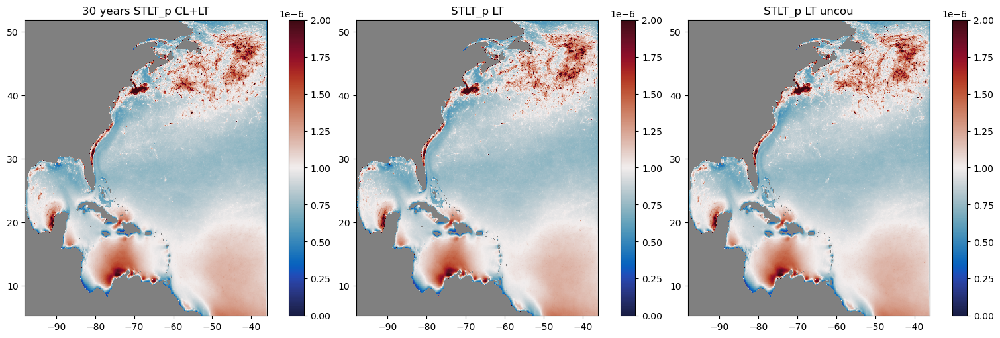

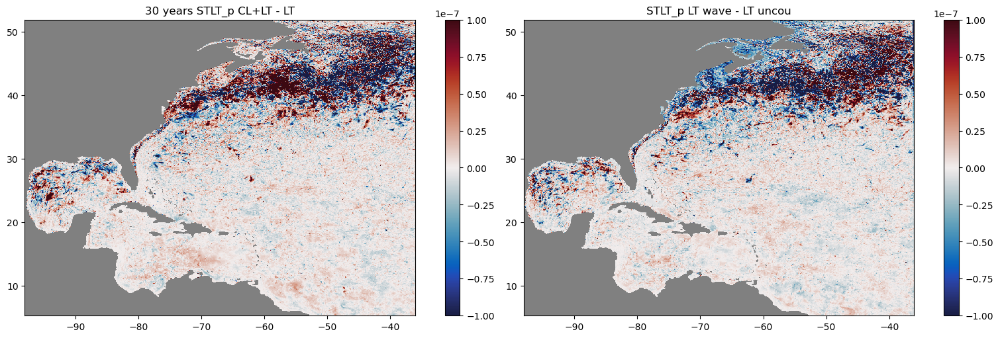

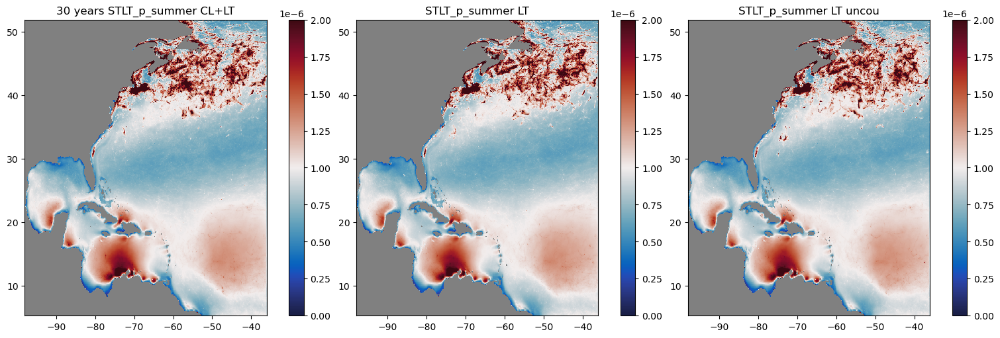

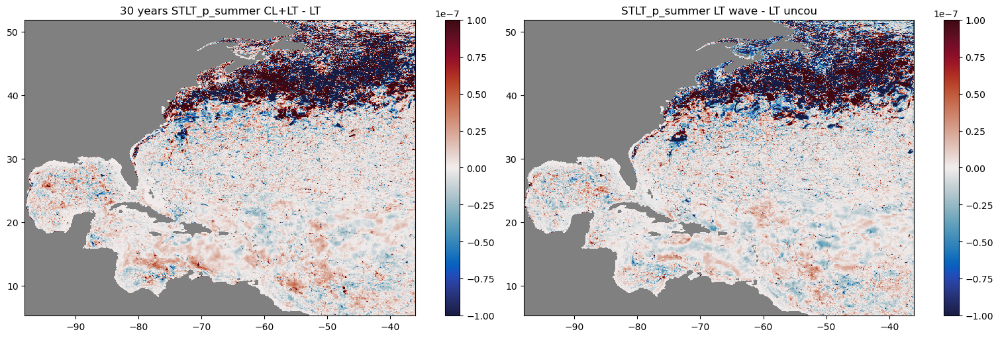

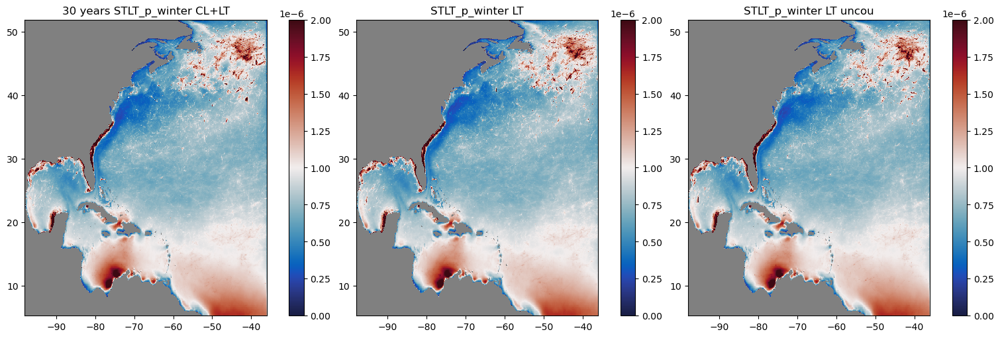

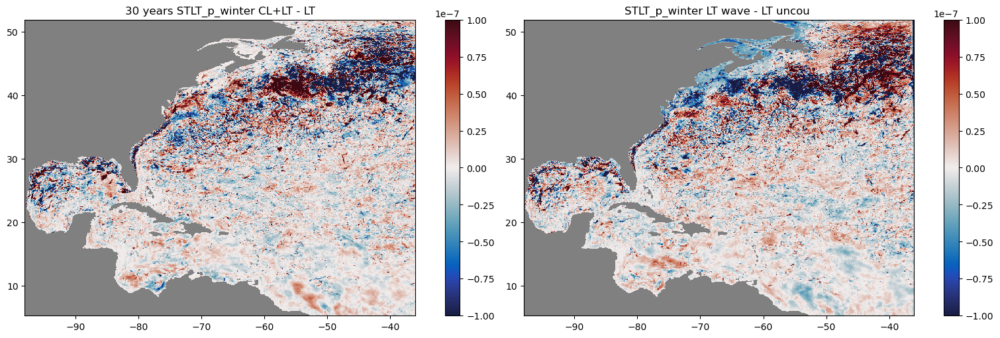

In [57]:
STLT_p_uncou_ave= Mcombined_data_uncou
STLT_p_summer_uncou_ave= Msummer_data_uncou
STLT_p_winter_uncou_ave= Mwinter_data_uncou


STLT_p_6_all_ave= Mcombined_data_6_all
STLT_p_summer_6_all_ave= Msummer_data_6_all
STLT_p_winter_6_all_ave= Mwinter_data_6_all


STLT_p_6_wave_ave= Mcombined_data_6_wave
STLT_p_summer_6_wave_ave= Msummer_data_6_wave
STLT_p_winter_6_wave_ave= Mwinter_data_6_wave



diff_STLT_p_uncou_ave=STLT_p_6_wave_ave -STLT_p_uncou_ave
diff_STLT_p_all_ave=STLT_p_6_all_ave-STLT_p_6_wave_ave

abs_max=1*(10 ** -7)
avmin,avmax=0, 0.2* (10 ** -5)
# Use symmetric range around 0
vmin, vmax = -abs_max, abs_max
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, STLT_p_6_all_ave , cmap=cmap, shading='auto', vmin=avmin, vmax=avmax)
axes[0].set_title('30 years STLT_p CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, STLT_p_6_wave_ave, cmap=cmap, shading='auto', vmin=avmin, vmax=avmax)
axes[1].set_title('STLT_p LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, STLT_p_uncou_ave, cmap=cmap, shading='auto', vmin=avmin, vmax=avmax)
axes[2].set_title('STLT_p LT uncou')
plt.colorbar(mesh2, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_STLT_p_all_ave , cmap=cmap, shading='auto', vmin=vmin, vmax=vmax)
axes[0].set_title('30 years STLT_p CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot
# axes[0].contour(model_grid_x, model_grid_y, diff_STLT_p_all_ave, levels=10, colors='black', linewidths=0.5)

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_STLT_p_uncou_ave, cmap=cmap, shading='auto', vmin=vmin, vmax=vmax)
axes[1].set_title('STLT_p LT wave - LT uncou')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
# axes[1].contour(model_grid_x, model_grid_y, diff_STLT_p_uncou_ave, levels=10, colors='black', linewidths=0.5)

plt.show()


diff_STLT_p_summer_uncou_ave=STLT_p_summer_6_wave_ave - STLT_p_summer_uncou_ave
diff_STLT_p_summer_all_ave=STLT_p_summer_6_all_ave-STLT_p_summer_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, STLT_p_summer_6_all_ave , cmap=cmap, shading='auto', vmin=avmin, vmax=avmax)
axes[0].set_title('30 years STLT_p_summer CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, STLT_p_summer_6_wave_ave, cmap=cmap, shading='auto', vmin=avmin, vmax=avmax)
axes[1].set_title('STLT_p_summer LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, STLT_p_summer_uncou_ave, cmap=cmap, shading='auto', vmin=avmin, vmax=avmax)
axes[2].set_title('STLT_p_summer LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot

# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_STLT_p_summer_all_ave , cmap=cmap, shading='auto', vmin=vmin, vmax=vmax)
axes[0].set_title('30 years STLT_p_summer CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_STLT_p_summer_uncou_ave, cmap=cmap, shading='auto', vmin=vmin, vmax=vmax)
axes[1].set_title('STLT_p_summer LT wave - LT uncou')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
plt.show()

diff_STLT_p_winter_uncou_ave= STLT_p_winter_6_wave_ave - STLT_p_winter_uncou_ave
diff_STLT_p_winter_all_ave=STLT_p_winter_6_all_ave-STLT_p_winter_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, STLT_p_winter_6_all_ave , cmap=cmap, shading='auto', vmin=avmin, vmax=avmax)
axes[0].set_title('30 years STLT_p_winter CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, STLT_p_winter_6_wave_ave, cmap=cmap, shading='auto', vmin=avmin, vmax=avmax)
axes[1].set_title('STLT_p_winter LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, STLT_p_winter_uncou_ave, cmap=cmap, shading='auto', vmin=avmin, vmax=avmax)
axes[2].set_title('STLT_p_winter LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot

# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_STLT_p_winter_all_ave , cmap=cmap, shading='auto', vmin=vmin, vmax=vmax)
axes[0].set_title('30 years STLT_p_winter CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_STLT_p_winter_uncou_ave, cmap=cmap, shading='auto', vmin=vmin, vmax=vmax)
axes[1].set_title('STLT_p_winter LT wave - LT uncou ')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot


plt.show()


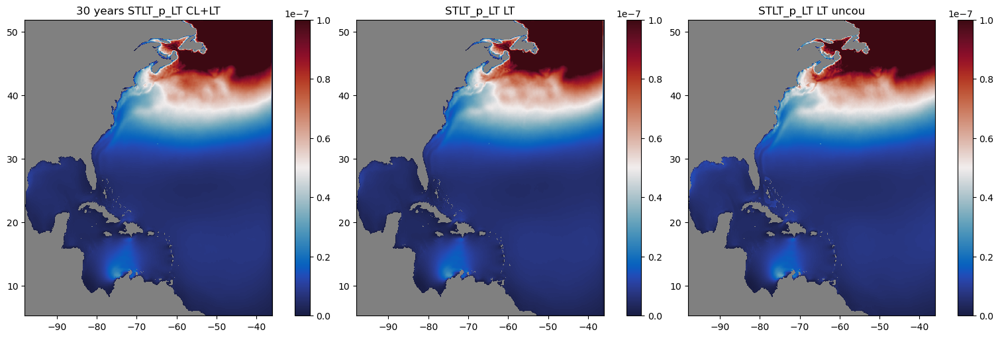

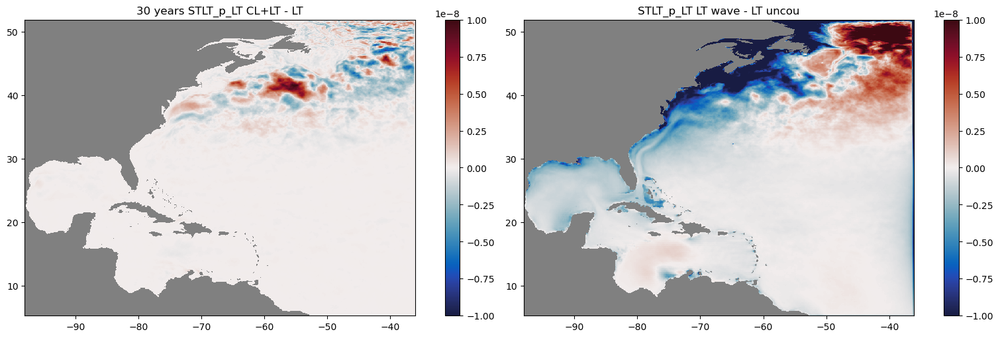

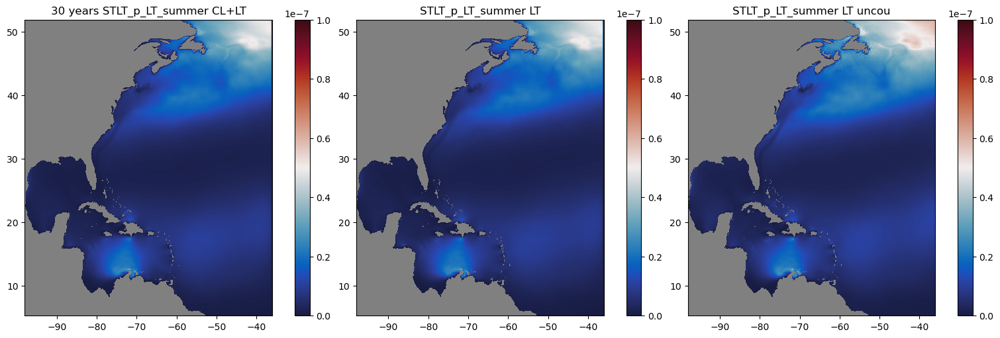

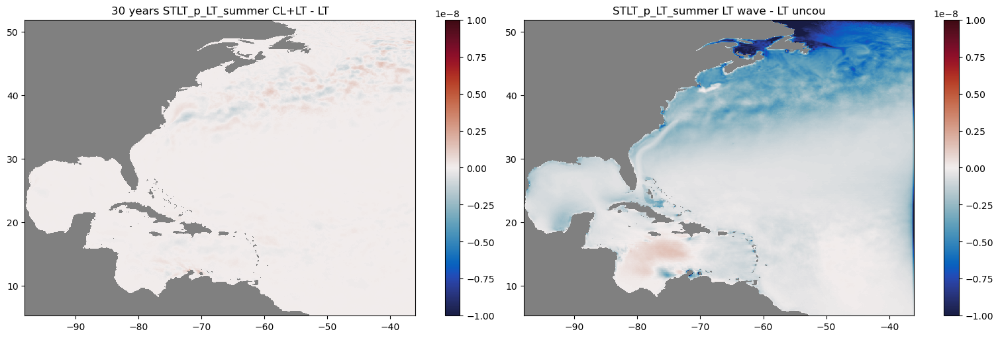

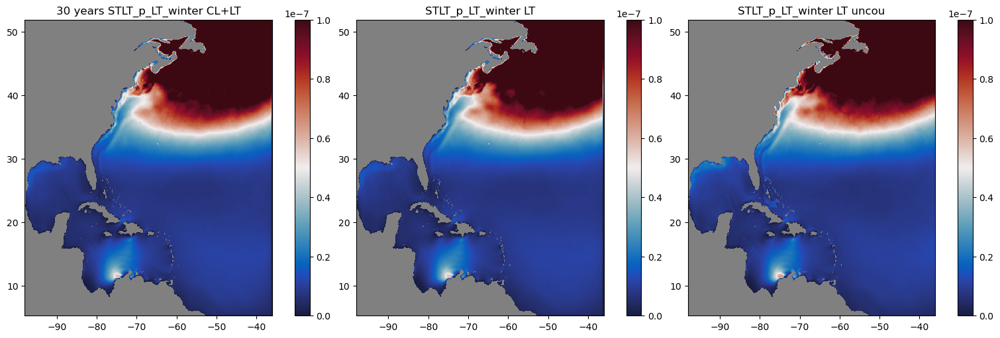

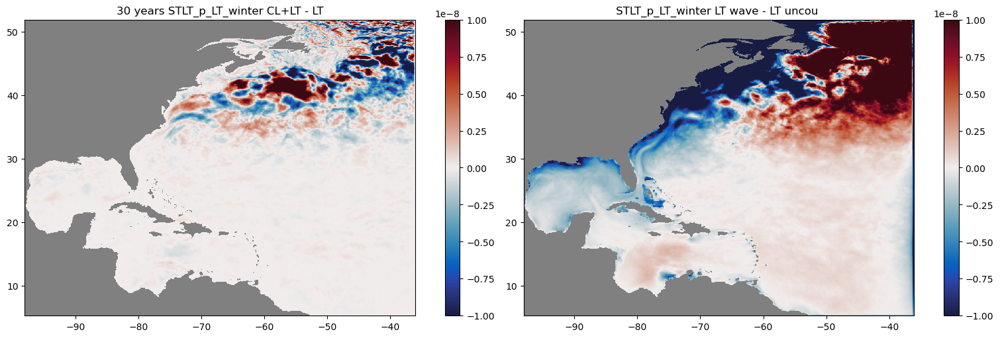

In [60]:
STLT_p_LT_uncou_ave= Mcombined_data_uncou_LT
STLT_p_LT_summer_uncou_ave= Msummer_data_uncou_LT
STLT_p_LT_winter_uncou_ave= Mwinter_data_uncou_LT


STLT_p_LT_6_all_ave= Mcombined_data_6_all_LT
STLT_p_LT_summer_6_all_ave= Msummer_data_6_all_LT
STLT_p_LT_winter_6_all_ave= Mwinter_data_6_all_LT


STLT_p_LT_6_wave_ave= Mcombined_data_6_wave_LT
STLT_p_LT_summer_6_wave_ave= Msummer_data_6_wave_LT
STLT_p_LT_winter_6_wave_ave= Mwinter_data_6_wave_LT



diff_STLT_p_LT_uncou_ave=STLT_p_LT_6_wave_ave -STLT_p_LT_uncou_ave
diff_STLT_p_LT_all_ave=STLT_p_LT_6_all_ave-STLT_p_LT_6_wave_ave

abs_max=1*(10 ** -8)
avmin,avmax=0, 1* (10 ** -7)
# Use symmetric range around 0
vmin, vmax = -abs_max, abs_max
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, STLT_p_LT_6_all_ave , cmap=cmap, shading='auto', vmin=avmin, vmax=avmax)
axes[0].set_title('30 years STLT_p_LT CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, STLT_p_LT_6_wave_ave, cmap=cmap, shading='auto', vmin=avmin, vmax=avmax)
axes[1].set_title('STLT_p_LT LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, STLT_p_LT_uncou_ave, cmap=cmap, shading='auto', vmin=avmin, vmax=avmax)
axes[2].set_title('STLT_p_LT LT uncou')
plt.colorbar(mesh2, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_STLT_p_LT_all_ave , cmap=cmap, shading='auto', vmin=vmin, vmax=vmax)
axes[0].set_title('30 years STLT_p_LT CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot
# axes[0].contour(model_grid_x, model_grid_y, diff_STLT_p_LT_all_ave, levels=10, colors='black', linewidths=0.5)

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_STLT_p_LT_uncou_ave, cmap=cmap, shading='auto', vmin=vmin, vmax=vmax)
axes[1].set_title('STLT_p_LT LT wave - LT uncou')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
# axes[1].contour(model_grid_x, model_grid_y, diff_STLT_p_LT_uncou_ave, levels=10, colors='black', linewidths=0.5)

plt.show()


diff_STLT_p_LT_summer_uncou_ave=STLT_p_LT_summer_6_wave_ave - STLT_p_LT_summer_uncou_ave
diff_STLT_p_LT_summer_all_ave=STLT_p_LT_summer_6_all_ave-STLT_p_LT_summer_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, STLT_p_LT_summer_6_all_ave , cmap=cmap, shading='auto', vmin=avmin, vmax=avmax)
axes[0].set_title('30 years STLT_p_LT_summer CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, STLT_p_LT_summer_6_wave_ave, cmap=cmap, shading='auto', vmin=avmin, vmax=avmax)
axes[1].set_title('STLT_p_LT_summer LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, STLT_p_LT_summer_uncou_ave, cmap=cmap, shading='auto', vmin=avmin, vmax=avmax)
axes[2].set_title('STLT_p_LT_summer LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot

# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_STLT_p_LT_summer_all_ave , cmap=cmap, shading='auto', vmin=vmin, vmax=vmax)
axes[0].set_title('30 years STLT_p_LT_summer CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_STLT_p_LT_summer_uncou_ave, cmap=cmap, shading='auto', vmin=vmin, vmax=vmax)
axes[1].set_title('STLT_p_LT_summer LT wave - LT uncou')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
plt.show()

diff_STLT_p_LT_winter_uncou_ave= STLT_p_LT_winter_6_wave_ave - STLT_p_LT_winter_uncou_ave
diff_STLT_p_LT_winter_all_ave=STLT_p_LT_winter_6_all_ave-STLT_p_LT_winter_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, STLT_p_LT_winter_6_all_ave , cmap=cmap, shading='auto', vmin=avmin, vmax=avmax)
axes[0].set_title('30 years STLT_p_LT_winter CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, STLT_p_LT_winter_6_wave_ave, cmap=cmap, shading='auto', vmin=avmin, vmax=avmax)
axes[1].set_title('STLT_p_LT_winter LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, STLT_p_LT_winter_uncou_ave, cmap=cmap, shading='auto', vmin=avmin, vmax=avmax)
axes[2].set_title('STLT_p_LT_winter LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot

# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_STLT_p_LT_winter_all_ave , cmap=cmap, shading='auto', vmin=vmin, vmax=vmax)
axes[0].set_title('30 years STLT_p_LT_winter CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_STLT_p_LT_winter_uncou_ave, cmap=cmap, shading='auto', vmin=vmin, vmax=vmax)
axes[1].set_title('STLT_p_LT_winter LT wave - LT uncou ')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot


plt.show()

In [65]:
Mdata_list = [

    '20040101_results/20040101.ocean_month.nc',
    '20050101_results/20050101.ocean_month.nc',
    '20060101_results/20060101.ocean_month.nc',
    '20070101_results/20070101.ocean_month.nc',
    '20080101_results/20080101.ocean_month.nc',
    '20090101_results/20090101.ocean_month.nc',
    '20100101_results/20100101.ocean_month.nc',
    '20110101_results/20110101.ocean_month.nc',
    '20120101_results/20120101.ocean_month.nc',
    '20130101_results/20130101.ocean_month.nc',
    '20140101_results/20140101.ocean_month.nc',
    '20150101_results/20150101.ocean_month.nc',
    '20160101_results/20160101.ocean_month.nc',
    '20170101_results/20170101.ocean_month.nc',
    '20180101_results/20180101.ocean_month.nc',
    '20190101_results/20190101.ocean_month.nc',
    '20200101_results/20200101.ocean_month.nc',
    '20210101_results/20210101.ocean_month.nc',
    '20220101_results/20220101.ocean_month.nc',

]
WMdata_list = [

    '20040101_results/20040101.ocean_month.nc',
    '20040701_results/20040701.ocean_month.nc',
    '20050101_results/20050101.ocean_month.nc',
    '20050701_results/20050701.ocean_month.nc',
    '20060101_results/20060101.ocean_month.nc',
    '20060701_results/20060701.ocean_month.nc',
    '20070101_results/20070101.ocean_month.nc',
    '20070701_results/20070701.ocean_month.nc',
    '20080101_results/20080101.ocean_month.nc',
    '20080701_results/20080701.ocean_month.nc',
    '20090101_results/20090101.ocean_month.nc',
    '20090701_results/20090701.ocean_month.nc',
    '20100101_results/20100101.ocean_month.nc',
    '20100701_results/20100701.ocean_month.nc',
    '20110101_results/20110101.ocean_month.nc',
    '20110701_results/20110701.ocean_month.nc',
    '20120101_results/20120101.ocean_month.nc',
    '20120701_results/20120701.ocean_month.nc',
    '20130101_results/20130101.ocean_month.nc',
    '20130701_results/20130701.ocean_month.nc',
    '20140101_results/20140101.ocean_month.nc',
    '20140701_results/20140701.ocean_month.nc',
    '20150101_results/20150101.ocean_month.nc',
    '20150701_results/20150701.ocean_month.nc',
    '20160101_results/20160101.ocean_month.nc',
    '20160701_results/20160701.ocean_month.nc',
    '20170101_results/20170101.ocean_month.nc',
    '20170701_results/20170701.ocean_month.nc',
    '20180101_results/20180101.ocean_month.nc',
    '20180701_results/20180701.ocean_month.nc',
    '20190101_results/20190101.ocean_month.nc',
    '20190701_results/20190701.ocean_month.nc',
    '20200101_results/20200101.ocean_month.nc',
    '20200701_results/20200701.ocean_month.nc',
    '20210101_results/20210101.ocean_month.nc',
    '20210701_results/20210701.ocean_month.nc',
    '20220101_results/20220101.ocean_month.nc',
    '20220701_results/20220701.ocean_month.nc',
]
# variables_month = ['ssh','speed','MLD_EN1','LA','LA_MOD','MSTAR_LT','La_turbulent','surface_stokes_x','surface_stokes_y']
variables_month = ['MSTAR_LT','MSTAR']

Mcombined_data_uncou, Msummer_data_uncou, Mwinter_data_uncou = read_and_extract_data_weightedmean(pp_root_uncou, Mdata_list, variables_month)

Mcombined_data_6_wave, Msummer_data_6_wave, Mwinter_data_6_wave = read_and_extract_data_weightedmean(pp_root_6_wave, WMdata_list, variables_month)

Mcombined_data_6_all, Msummer_data_6_all, Mwinter_data_6_all = read_and_extract_data_weightedmean(pp_root_6_all, WMdata_list, variables_month)





/vftmp/Qian.Xiao/pid2005190/ipykernel_2046315/2482195342.py:88: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)
/vftmp/Qian.Xiao/pid2005190/ipykernel_2046315/2482195342.py:88: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)
/vftmp/Qian.Xiao/pid2005190/ipykernel_2046315/2482195342.py:88: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)
/vftmp/Qian.Xiao/pid2005190/ipykernel_2046315/2482195342.py:88: FutureWarning: In a future version of xarray dec

/vftmp/Qian.Xiao/pid2005190/ipykernel_2046315/4001453555.py:1: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ocean_daily_uncou_1= xr.open_dataset(pp_root_uncou+"/19930101_results/19930101.ocean_daily.nc")


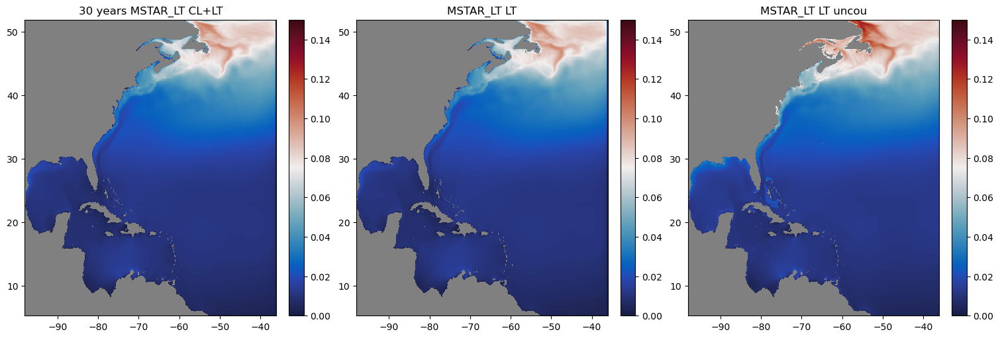

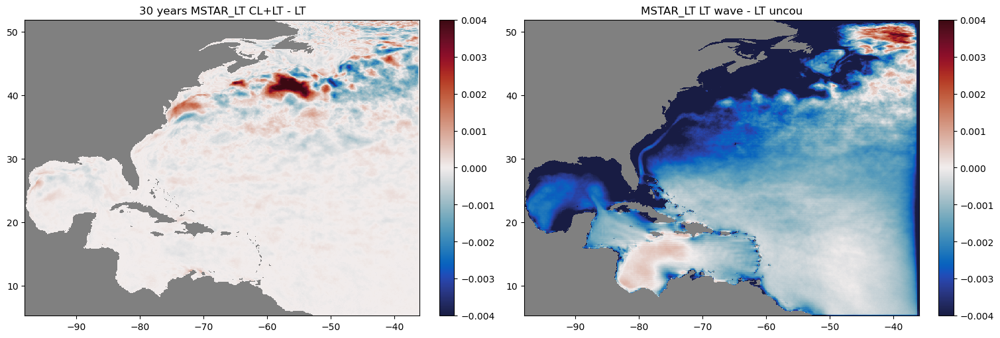

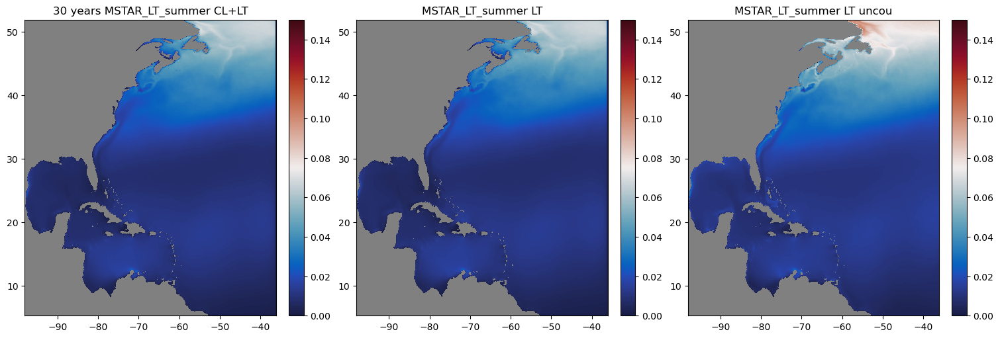

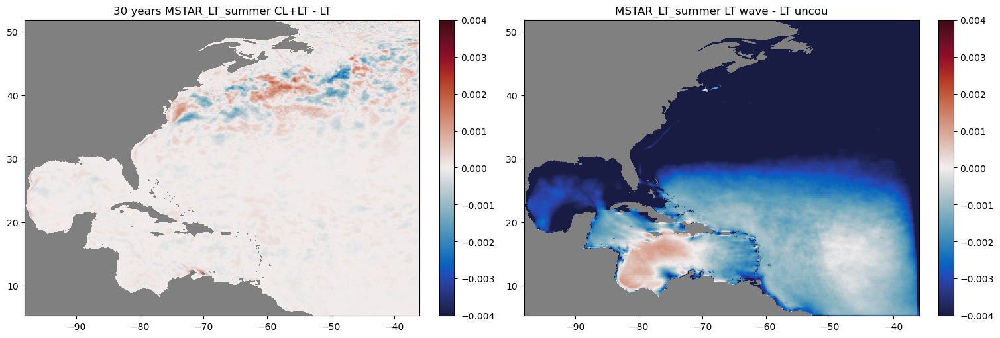

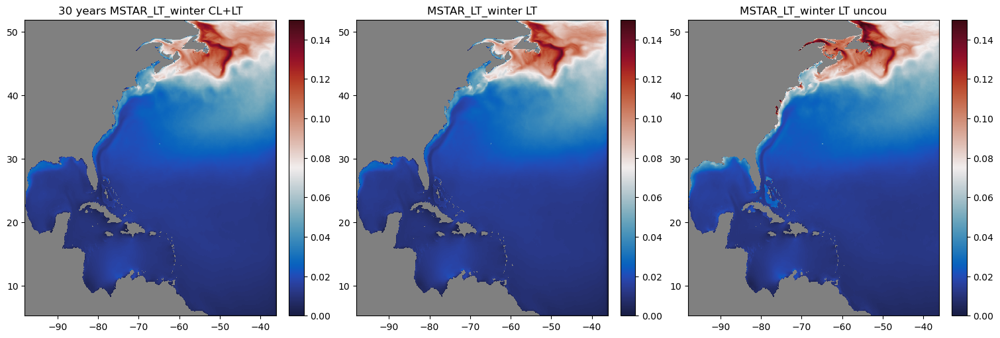

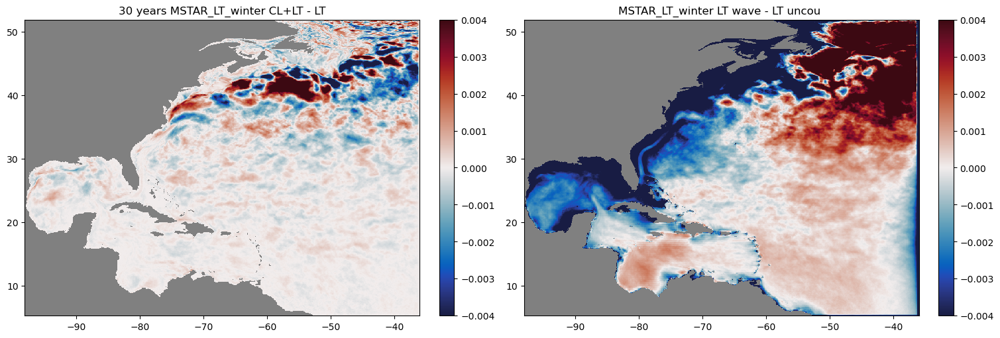

In [66]:
ocean_daily_uncou_1= xr.open_dataset(pp_root_uncou+"/19930101_results/19930101.ocean_daily.nc")
model_grid_x = ocean_daily_uncou_1.variables['xh']
model_grid_y = ocean_daily_uncou_1.variables['yh']

MSTAR_LT_uncou= Mcombined_data_uncou['MSTAR_LT']
MSTAR_LT_summer_uncou= Msummer_data_uncou['MSTAR_LT']
MSTAR_LT_winter_uncou= Mwinter_data_uncou['MSTAR_LT']
MSTAR_LT_uncou_ave=MSTAR_LT_uncou
MSTAR_LT_summer_uncou_ave=MSTAR_LT_summer_uncou
MSTAR_LT_winter_uncou_ave=MSTAR_LT_winter_uncou

MSTAR_LT_6_all= Mcombined_data_6_all['MSTAR_LT']
MSTAR_LT_summer_6_all= Msummer_data_6_all['MSTAR_LT']
MSTAR_LT_winter_6_all= Mwinter_data_6_all['MSTAR_LT']
MSTAR_LT_6_all_ave=MSTAR_LT_6_all
MSTAR_LT_summer_6_all_ave=MSTAR_LT_summer_6_all
MSTAR_LT_winter_6_all_ave=MSTAR_LT_winter_6_all

MSTAR_LT_6_wave= Mcombined_data_6_wave['MSTAR_LT']
MSTAR_LT_summer_6_wave= Msummer_data_6_wave['MSTAR_LT']
MSTAR_LT_winter_6_wave= Mwinter_data_6_wave['MSTAR_LT']
MSTAR_LT_6_wave_ave=MSTAR_LT_6_wave
MSTAR_LT_summer_6_wave_ave=MSTAR_LT_summer_6_wave
MSTAR_LT_winter_6_wave_ave=MSTAR_LT_winter_6_wave


diff_MSTAR_LT_uncou_ave=MSTAR_LT_6_wave_ave -MSTAR_LT_uncou_ave
diff_MSTAR_LT_all_ave=MSTAR_LT_6_all_ave-MSTAR_LT_6_wave_ave

abs_max=0.004
avmin,avmax=0,0.15
# Use symmetric range around 0
vmin, vmax = -abs_max, abs_max
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, MSTAR_LT_6_all_ave , cmap=cmap, shading='auto', vmin=avmin, vmax=avmax)
axes[0].set_title('30 years MSTAR_LT CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, MSTAR_LT_6_wave_ave, cmap=cmap, shading='auto', vmin=avmin, vmax=avmax)
axes[1].set_title('MSTAR_LT LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, MSTAR_LT_uncou_ave, cmap=cmap, shading='auto', vmin=avmin, vmax=avmax)
axes[2].set_title('MSTAR_LT LT uncou')
plt.colorbar(mesh2, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_MSTAR_LT_all_ave , cmap=cmap, shading='auto', vmin=vmin, vmax=vmax)
axes[0].set_title('30 years MSTAR_LT CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot
# axes[0].contour(model_grid_x, model_grid_y, diff_MSTAR_LT_all_ave, levels=10, colors='black', linewidths=0.5)

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_MSTAR_LT_uncou_ave,cmap=cmap, shading='auto', vmin=vmin, vmax=vmax)
axes[1].set_title('MSTAR_LT LT wave - LT uncou')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
# axes[1].contour(model_grid_x, model_grid_y, diff_MSTAR_LT_uncou_ave, levels=10, colors='black', linewidths=0.5)

plt.show()


diff_MSTAR_LT_summer_uncou_ave=MSTAR_LT_summer_6_wave_ave - MSTAR_LT_summer_uncou_ave
diff_MSTAR_LT_summer_all_ave=MSTAR_LT_summer_6_all_ave-MSTAR_LT_summer_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, MSTAR_LT_summer_6_all_ave , cmap=cmap, shading='auto', vmin=avmin, vmax=avmax)
axes[0].set_title('30 years MSTAR_LT_summer CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, MSTAR_LT_summer_6_wave_ave, cmap=cmap, shading='auto', vmin=avmin, vmax=avmax)
axes[1].set_title('MSTAR_LT_summer LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, MSTAR_LT_summer_uncou_ave, cmap=cmap, shading='auto', vmin=avmin, vmax=avmax)
axes[2].set_title('MSTAR_LT_summer LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot

# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_MSTAR_LT_summer_all_ave , cmap=cmap, shading='auto', vmin=vmin, vmax=vmax)
axes[0].set_title('30 years MSTAR_LT_summer CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_MSTAR_LT_summer_uncou_ave, cmap=cmap, shading='auto', vmin=vmin, vmax=vmax)
axes[1].set_title('MSTAR_LT_summer LT wave - LT uncou')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
plt.show()

diff_MSTAR_LT_winter_uncou_ave= MSTAR_LT_winter_6_wave_ave - MSTAR_LT_winter_uncou_ave
diff_MSTAR_LT_winter_all_ave=MSTAR_LT_winter_6_all_ave-MSTAR_LT_winter_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, MSTAR_LT_winter_6_all_ave , cmap=cmap, shading='auto', vmin=avmin, vmax=avmax)
axes[0].set_title('30 years MSTAR_LT_winter CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, MSTAR_LT_winter_6_wave_ave, cmap=cmap, shading='auto', vmin=avmin, vmax=avmax)
axes[1].set_title('MSTAR_LT_winter LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, MSTAR_LT_winter_uncou_ave, cmap=cmap, shading='auto', vmin=avmin, vmax=avmax)
axes[2].set_title('MSTAR_LT_winter LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot

# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_MSTAR_LT_winter_all_ave , cmap=cmap, shading='auto', vmin=vmin, vmax=vmax)
axes[0].set_title('30 years MSTAR_LT_winter CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_MSTAR_LT_winter_uncou_ave, cmap=cmap, shading='auto', vmin=vmin, vmax=vmax)
axes[1].set_title('MSTAR_LT_winter LT wave - LT uncou ')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot


plt.show()

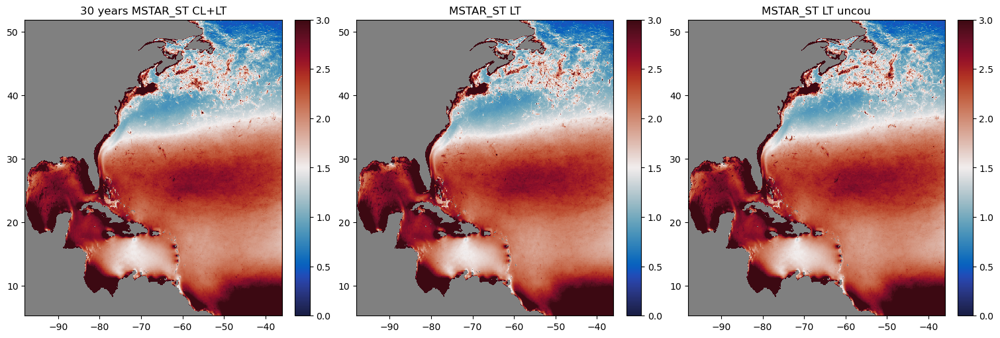

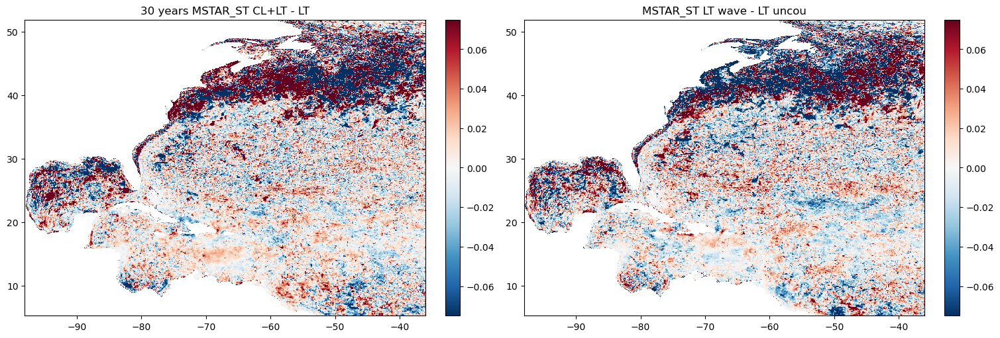

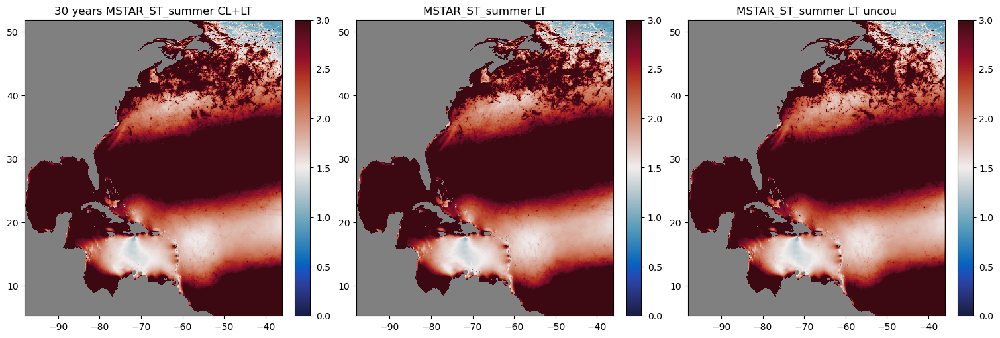

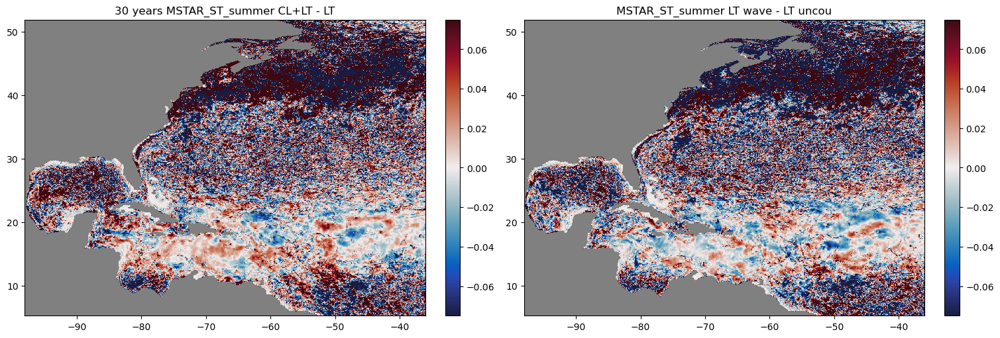

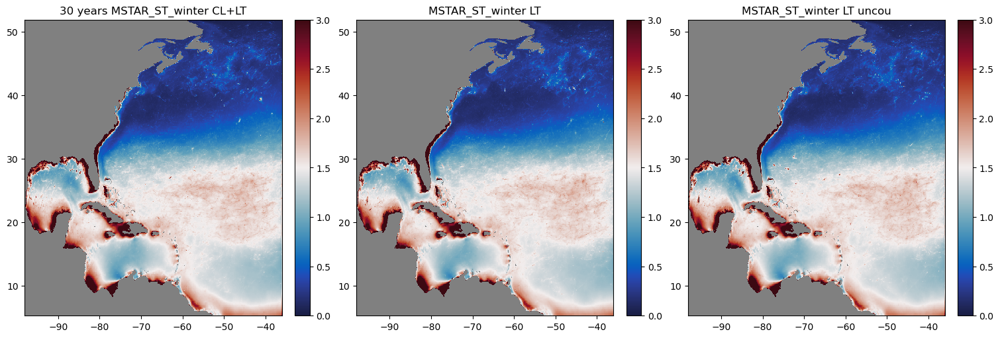

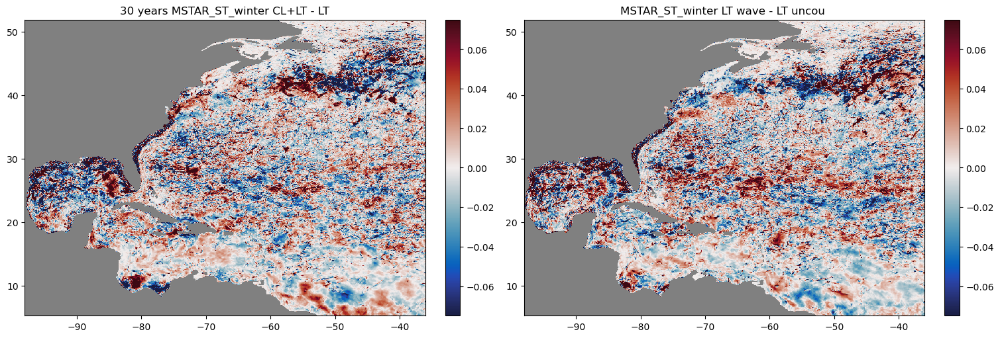

In [67]:
MSTAR_uncou= Mcombined_data_uncou['MSTAR']
MSTAR_summer_uncou= Msummer_data_uncou['MSTAR']
MSTAR_winter_uncou= Mwinter_data_uncou['MSTAR']
MSTAR_ST_uncou=MSTAR_uncou-MSTAR_LT_uncou
MSTAR_ST_summer_uncou=MSTAR_summer_uncou-MSTAR_LT_summer_uncou
MSTAR_ST_winter_uncou=MSTAR_winter_uncou-MSTAR_LT_winter_uncou

MSTAR_ST_uncou_ave=MSTAR_ST_uncou
MSTAR_ST_summer_uncou_ave=MSTAR_ST_summer_uncou
MSTAR_ST_winter_uncou_ave=MSTAR_ST_winter_uncou

MSTAR_6_all= Mcombined_data_6_all['MSTAR']
MSTAR_summer_6_all= Msummer_data_6_all['MSTAR']
MSTAR_winter_6_all= Mwinter_data_6_all['MSTAR']
MSTAR_ST_6_all=MSTAR_6_all-MSTAR_LT_6_all
MSTAR_ST_summer_6_all=MSTAR_summer_6_all-MSTAR_LT_summer_6_all
MSTAR_ST_winter_6_all=MSTAR_winter_6_all-MSTAR_LT_winter_6_all
MSTAR_ST_6_all_ave=MSTAR_ST_6_all
MSTAR_ST_summer_6_all_ave=MSTAR_ST_summer_6_all
MSTAR_ST_winter_6_all_ave=MSTAR_ST_winter_6_all

MSTAR_6_wave= Mcombined_data_6_wave['MSTAR']
MSTAR_summer_6_wave= Msummer_data_6_wave['MSTAR']
MSTAR_winter_6_wave= Mwinter_data_6_wave['MSTAR']
MSTAR_ST_6_wave=MSTAR_6_wave-MSTAR_LT_6_wave
MSTAR_ST_summer_6_wave=MSTAR_summer_6_wave-MSTAR_LT_summer_6_wave
MSTAR_ST_winter_6_wave=MSTAR_winter_6_wave-MSTAR_LT_winter_6_wave

MSTAR_ST_6_wave_ave=MSTAR_ST_6_wave
MSTAR_ST_summer_6_wave_ave=MSTAR_ST_summer_6_wave
MSTAR_ST_winter_6_wave_ave=MSTAR_ST_winter_6_wave


diff_MSTAR_ST_uncou_ave=MSTAR_ST_6_wave_ave -MSTAR_ST_uncou_ave
diff_MSTAR_ST_all_ave=MSTAR_ST_6_all_ave-MSTAR_ST_6_wave_ave

abs_max=0.075
avmin,avmax=0,3
# Use symmetric range around 0
vmin, vmax = -abs_max, abs_max
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, MSTAR_ST_6_all_ave , cmap=cmap, shading='auto', vmin=avmin, vmax=avmax)
axes[0].set_title('30 years MSTAR_ST CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, MSTAR_ST_6_wave_ave, cmap=cmap, shading='auto', vmin=avmin, vmax=avmax)
axes[1].set_title('MSTAR_ST LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, MSTAR_ST_uncou_ave, cmap=cmap, shading='auto', vmin=avmin, vmax=avmax)
axes[2].set_title('MSTAR_ST LT uncou')
plt.colorbar(mesh2, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_MSTAR_ST_all_ave , cmap='RdBu_r', shading='auto', vmin=vmin, vmax=vmax)
axes[0].set_title('30 years MSTAR_ST CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot
# axes[0].contour(model_grid_x, model_grid_y, diff_MSTAR_ST_all_ave, levels=10, colors='black', linewidths=0.5)

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_MSTAR_ST_uncou_ave, cmap='RdBu_r', shading='auto', vmin=vmin, vmax=vmax)
axes[1].set_title('MSTAR_ST LT wave - LT uncou')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
# axes[1].contour(model_grid_x, model_grid_y, diff_MSTAR_ST_uncou_ave, levels=10, colors='black', linewidths=0.5)

plt.show()


diff_MSTAR_ST_summer_uncou_ave=MSTAR_ST_summer_6_wave_ave - MSTAR_ST_summer_uncou_ave
diff_MSTAR_ST_summer_all_ave=MSTAR_ST_summer_6_all_ave-MSTAR_ST_summer_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, MSTAR_ST_summer_6_all_ave , cmap=cmap, shading='auto', vmin=avmin, vmax=avmax)
axes[0].set_title('30 years MSTAR_ST_summer CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, MSTAR_ST_summer_6_wave_ave, cmap=cmap, shading='auto', vmin=avmin, vmax=avmax)
axes[1].set_title('MSTAR_ST_summer LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, MSTAR_ST_summer_uncou_ave, cmap=cmap, shading='auto', vmin=avmin, vmax=avmax)
axes[2].set_title('MSTAR_ST_summer LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot

# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_MSTAR_ST_summer_all_ave , cmap=cmap, shading='auto', vmin=vmin, vmax=vmax)
axes[0].set_title('30 years MSTAR_ST_summer CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_MSTAR_ST_summer_uncou_ave, cmap=cmap, shading='auto', vmin=vmin, vmax=vmax)
axes[1].set_title('MSTAR_ST_summer LT wave - LT uncou')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
plt.show()

diff_MSTAR_ST_winter_uncou_ave= MSTAR_ST_winter_6_wave_ave - MSTAR_ST_winter_uncou_ave
diff_MSTAR_ST_winter_all_ave=MSTAR_ST_winter_6_all_ave-MSTAR_ST_winter_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, MSTAR_ST_winter_6_all_ave , cmap=cmap, shading='auto', vmin=avmin, vmax=avmax)
axes[0].set_title('30 years MSTAR_ST_winter CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, MSTAR_ST_winter_6_wave_ave, cmap=cmap, shading='auto', vmin=avmin, vmax=avmax)
axes[1].set_title('MSTAR_ST_winter LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, MSTAR_ST_winter_uncou_ave, cmap=cmap, shading='auto', vmin=avmin, vmax=avmax)
axes[2].set_title('MSTAR_ST_winter LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot

# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_MSTAR_ST_winter_all_ave , cmap=cmap, shading='auto', vmin=vmin, vmax=vmax)
axes[0].set_title('30 years MSTAR_ST_winter CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_MSTAR_ST_winter_uncou_ave, cmap=cmap, shading='auto', vmin=vmin, vmax=vmax)
axes[1].set_title('MSTAR_ST_winter LT wave - LT uncou ')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot


plt.show()